#  Supervised and unsupervised real-bogus classifiers for astronomical data

*Zizheng Xu, Manish Reddy Vuyyuru, Yuhao Lu*  

Advanced Topics in Data Science


## 1. Motivation

Modern time-domain surveys monitor large swaths of the sky to look for interesting astronomical objects, including near-earth objects, unidentified planetesimals, and transits. Imperfect CCD, optics reflection, atmospheric effects and a bunch of other factors contribute to the presence of bogus detections. They contaminates real detections of transitions, Variable stars and planetesimals, adding to the difficulty against our effort to spot real interesting celestial objects.

Taking into account that we expect to observe ~200k objects in one single exposure in one of the four apertures on Pan-STARRS telescope, it is impossible for us to manually examine whether a detection is real or bogus. Also, sometimes visual examination helps, but does not solve the problem either, due to either huma error in such big volumes of data, and the cost of time. We need an automatic solution to distinguish bogus detections from real ones.

## 2. Executive Summary

We first present several supervised methods of distinguishing real and bogus detections. We demonstrate that these can be well trained to predict the match labels. 

**supervised models**

| Methods (Evaluated On A Single SMF File)             | True Negative Rate   | False Negative Rate  |
| :------------------- |:--------------------:|:--------------------:|
| Logistic - L1 (All Linear Features) |         0.811        |         0.098        |
| Logistic - L1 (All Features Up To Power 2, Incl. Interaction Terms) |         0.823        |         0.093        |
| Logistic - L2 (Chosen Features) |         0.837        |         0.100        |
| SVC (Chosen Features) |         0.762        |         0.089        |
| **Ensemble Learning** | | |
| AdaBoost (Logistic - L2) |         0.804        |         0.093        |
| Bagging (Logistic - L2) |         0.770        |         0.098        |
| Bagging (SVC) |         0.655        |         0.069        |
| **Evaluated On All SMF Files**          |  |  |
| Bagging (Logistic - L2) |         0.741        |         0.107        |
| Dense Neural Network    |         0.667        |         0.071        |

However, by being obsessed in training supervised methods to chase the match labels, one is missing the real question here. The main issue for Astronomists are, whether there is a method to tell whether a detection is real or not, rather than predicting whether a detection will be matched by catalog. Plus, the catalog matching label is relatively easy to get, compared to the the real/bogus label. 

Based on the thought that real objects might share something in common over the parameter space, we implemented several unsupervised methods that demonstrate a promising direction for future work. We measured the performance of the unsupervised methods based on three quantities and tested their consistency over train/test split and over all the smf files we have. 

We summarise the performance of the methods on real-bogus classification below:







| Methods (Evaluated On a Single SMF File)  | Recall Rate   | Bogus Rate  | Edge-Bogus Rate  |
| :--------------------- |:-------------:|:-----------:|:----------------:|
| Baseline k-means |    0.53     |    0.51    |       0.02      |
| Initialized k-means |     0.90     |    0.30    |       0.65      |
| EM w. baseline prior |     0.80     |    0.24    |       0.09      |
| EM w. engineered prior |     0.79     |    0.23    |       0.05      |
| Variational Gaussian Mixture |     0.77     |    0.43    |       0.29      |
| **Evaluated On All SMF Files**  |     |   |    |
| Variational Gaussian Mixture |     0.76    |    0.33    |       0.21      |

## 3. Download required code and data

We directly use the smf files labelled with the stationary and moving objects from the catalog (labelled for us in Tutorial 3 Notebook). The files are hosted on Google Drive (see https://drive.google.com/open?id=12jYG_qgX6xp-X4iQnMStPJT9Av5oe-7l).

## 3. Imports

In [0]:
import glob
import math
import warnings
import operator
import keras

import numpy as np
from numpy.linalg import inv
import pandas as pd
import matplotlib.pyplot as plt

from astropy.io import fits
import pandas as pd
pd.set_option('display.max_columns', 999)
pd.set_option('display.width', 500)
pd.set_option('display.notebook_repr_html', True)

import ps1_utils
from matplotlib.colors import PowerNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable

from sklearn.svm import SVC
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
from sklearn import preprocessing
from sklearn import cluster
from sklearn.cluster import KMeans
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier
from sklearn.exceptions import DataConversionWarning
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.mixture.base import BaseMixture
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import OneHotEncoder
from sklearn.utils import resample
from scipy.stats import ttest_rel
from tqdm import tqdm_notebook as tqdm
import time
import warnings
warnings.warn("future", FutureWarning)
warnings.simplefilter("ignore")

Using TensorFlow backend.
/home/xzz/.local/lib/python3.6/site-packages/ipykernel_launcher.py:43: FutureWarning: future


## 4. Definitions


In [0]:
def read_chip(chip_name, hdus=None, manual_interaction_terms=False):
    # given name of smf file and name of chip to read, reads it and appends engineered features, either designed by us or 
    # provided in notebook tutorial 2
    
    if hdus is None:
        raise ValueError('specify a hdus file to read from!')
    
    chip_name = chip_name+'.psf'
    df = pd.DataFrame()
    
    cols = hdus[chip_name].columns
    for i in range(len(cols)):
        if cols[i].name == 'MOVING':            
            #remove moving objects as a feature, we will consider these as matched objects
            continue
        data = hdus[chip_name].data[cols[i].name].byteswap().newbyteorder()
        df[cols[i].name] = data
            
    #add moving objects as a matched object
    df.loc[hdus[chip_name].data['MOVING'].byteswap().newbyteorder() == 1, 'MATCH'] = 1
    
    #drop suspicious columns
    df = df[~np.isnan(hdus[chip_name].data['AP_MAG_RAW'])]
    df = df[~np.isinf(df['AP_MAG_RAW'])]
    df.dropna()    
    
    
    #add header information to chips that we believe might be useful
    df['zptObs'] = np.array([hdus['PRIMARY'].header["ZPT_OBS"]] * len(df))
    df['filterID'] = np.array([hdus['PRIMARY'].header["FILTERID"]] * len(df))
    df['RA']       = np.array([hdus['PRIMARY'].header["RA"]] * len(df))
    df['Dec']      = np.array([hdus['PRIMARY'].header["DEC"]] * len(df))
    df['exptime']  = np.array([hdus['PRIMARY'].header["EXPTIME"]] * len(df))
    df['mjdObs']   = np.array([hdus['PRIMARY'].header["MJD-OBS"]] * len(df))
    df['airmass']  = np.array([hdus['PRIMARY'].header["AIRMASS"]] * len(df))
    df['jd'] = np.array([hdus['PRIMARY'].header["MJD-OBS"] + 2400000.5] * len(df))
    
    qfp_thresh=0.1
    df['PST_QF_PERFECT_MEET_THRES'] = np.sum(hdus[chip_name].data['PSF_QF_PERFECT']>qfp_thresh)        
    
    #calculate engineered features, either manually designed or from tutorial 2
    platescale = df['PLTSCALE']
    df['ra_sig_rescaled'] = df['X_PSF_SIG']*platescale    
    df['dec_sig_rescaled'] =  df['Y_PSF_SIG']*platescale
    df['psf_major_rescaled'] =  df['PSF_MAJOR']*platescale
    df['psf_minor_rescaled'] = df['PSF_MINOR']*platescale
    df['fwhm_mean'] = np.sqrt(df['psf_major_rescaled']*df['psf_minor_rescaled'])*2.3548
    

    df['mag0'] = df['CAL_PSF_MAG']
    df['mag1'] = df['PSF_INST_MAG'] + hdus['PRIMARY'].header["ZPT_OBS"] + 2.5*math.log10(hdus['PRIMARY'].header["EXPTIME"])
    
    df['moments_r1_rescaled'] = df['MOMENTS_R1'] * platescale
    df['psf_extent'] = (df['MOMENTS_R1'] * df['MOMENTS_R1'])/(df['psf_major_rescaled'] * df['psf_minor_rescaled'])
    
    df['SNR'] = df['PSF_INST_FLUX'] / df['PSF_INST_FLUX_SIG']
        
    #decrypt the BAD FLAGS column into their own one hot encoded features
    df['SATURATED'] = 0
    df.loc[df['FLAGS'] & 8 != 0, 'SATURATED'] = 1    
    df['FAIL'] = 0
    df.loc[df['FLAGS'] & 16 != 0, 'FAIL'] = 1
    df['SATSTAR'] = 0
    df.loc[df['FLAGS'] & 128 != 0, 'SATSTAR'] = 1
    df['POOR'] = 0
    df.loc[df['FLAGS'] & 2048 != 0, 'POOR'] = 1
    df['ON_SPIKE'] = 0
    df.loc[df['FLAGS'] & 4096 != 0, 'ON_SPIKE'] = 1
    df['SKY_FAILURE'] = 0
    df.loc[df['FLAGS'] & 8192 != 0, 'SKY_FAILURE'] = 1
    df['SKYVAR_FAILURE'] = 0
    df.loc[df['FLAGS'] & 32768 != 0, 'SKYVAR_FAILURE'] = 1
    df['ON_GHOST'] = 0
    df.loc[df['FLAGS'] & 65536 != 0, 'ON_GHOST'] = 1
    df['BELOW_MOMENTS_SN'] = 0
    df.loc[df['FLAGS'] & 131072 != 0, 'BELOW_MOMENTS_SN'] = 1
    df['CR_LIMIT'] = 0
    df.loc[df['FLAGS'] & 262144 != 0, 'CR_LIMIT'] = 1
    df['DEFECT'] = 0
    df.loc[df['FLAGS'] & 268435456 != 0, 'DEFECT'] = 1
    df['SIZE_SKIPPED'] = 0
    df.loc[df['FLAGS'] & 536870912  != 0, 'SIZE_SKIPPED'] = 1
    df['OFF_CHIP'] = 0
    df.loc[df['FLAGS'] & 1073741824 != 0, 'OFF_CHIP'] = 1
    df['MOMENTS_FAILURE'] = 0
    df.loc[df['FLAGS'] & 2147483648 != 0, 'MOMENTS_FAILURE'] = 1
    
    #drop columns that seem to be giving us issues and that we don't intend to use in our features
    df = df.drop(['filterID', 'N_FRAMES', 'CR_NSIGMA','KRON_FLUX_OUTER'], axis=1)    
    
    if manual_interaction_terms:
        #interaction terms defined manually :)
        df['PEAK_FLUX_AS_MAG_SQUARED'] = df['PEAK_FLUX_AS_MAG']**2
        df['PSF_QF_PERFECT_SQUARED'] = df['PSF_QF_PERFECT']**2
        df['MOMENTS_M4C_SQUARED'] = df['MOMENTS_M4C']**2
        df['PSF_QF_PERFECT_x_MOMENTS_YY'] = df['PSF_QF_PERFECT'] * df['MOMENTS_YY']
        df['PST_INST_MAG_SIG_x_KRON_FLUX_INNER'] = df['PSF_INST_MAG_SIG'] * df['KRON_FLUX_INNER']
        df['EXT_NSIGMA_x_IPP_IDET'] = df['EXT_NSIGMA'] * df['IPP_IDET']
        df['PSF_QF_PERFECT_x_SNR'] = df['PSF_QF_PERFECT'] * df['SNR']
        df['IPP_IDET_x_MOMENTS_R1'] = df['IPP_IDET']* df['MOMENTS_R1']
        df['EXT_NSIGMA_SQUARED'] = df['EXT_NSIGMA']**2
        df['IPP_IDET_x_MOMENTS_YY'] = df['IPP_IDET'] * df['MOMENTS_YY']
        df['SNR_x_PSF_QF'] = df['SNR'] * df['PSF_QF']
        df['PSF_INST_MAG_SIG_x_EXT_NSIGMA'] = df['PSF_INST_MAG_SIG']* df['EXT_NSIGMA']
        df['SNR_x_IPP_IDET'] = df['SNR'] * df['IPP_IDET']
        df['PSF_INST_MAG_SIG_x_IPP_IDET'] = df['PSF_INST_MAG_SIG'] * df['IPP_IDET']
        df['PSF_QF_SQUARED'] = df['PSF_QF']**2
        df['PSF_QF_PERFECT_x_PSF_QF'] = df['PSF_QF_PERFECT'] * df['PSF_QF']
        df['PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG'] = df['PSF_QF_PERFECT'] * df['PEAK_FLUX_AS_MAG']
        df['EXT_NSIGMA_x_MOMENTS_M4C'] = df['EXT_NSIGMA'] * df['MOMENTS_M4C']
    
    return df

def fetch_1features(features, label='MATCH', hdus=None):
    #fetches parts of the array that have a flag (label) set to 1 or 0
    if hdus is None:
        raise ValueError('please provide a hdus to read data from!')
    X1 = np.array([])    
    X0 = np.array([])    
    for chip in chips:
        edge_indices = np.where(hdus[chip+'.psf'].data[label] == 1)
        noedge_indices = np.where(hdus[chip+'.psf'].data[label] == 0)
        for feature in features:
            X1 = np.append(X1, hdus[chip+'.psf'].data[feature][edge_indices])
            X0 = np.append(X0, hdus[chip+'.psf'].data[feature][noedge_indices])    
    return X1, X0

def EDA_1D(features, label='match', bins=None, density=True, axis=None, logy=False, logx=False, hdus=None):
    # helper fn. for EDA plots
    # features: features to look at
    # label: match or edge
    assert len(features) == 1,'Use one feature only!'
    if hdus is None:
        raise ValueError('please provide a hdus to read data from!')
    X_edge,X_noedge = fetch_1features(features,label=label,hdus=hdus)
    X_edge=X_edge[~np.isnan(X_edge)]
    X_noedge=X_noedge[~np.isnan(X_noedge)]
            
    if axis is None:
        plt.hist(X_edge,bins = bins,alpha=0.5,label=label, density =density)
        plt.hist(X_noedge,bins = bins ,alpha=0.5,label='no_'+label,density =density )
        plt.legend()
        plt.title(' '.join(features))
    else:
        axis.hist(X_edge,bins = bins,alpha=0.5,label=label, density =density)
        axis.hist(X_noedge,bins = bins ,alpha=0.5,label='no_'+label,density =density )
        axis.legend()
        if logy:
            axis.set_yscale('log')
        if logx:
            axis.set_xscale('log')
                
        axis.set_title( features[0])

def fetch_2features(features,label='MATCH', hdus=None):
    if hdus is None:
        raise ValueError('please provide a hdus to read data from!')
    
    #just 2d version of fetch_1features
    X_edge = [[],[]]
    X_noedge = [[],[]]
    for chip in chips:
        edge_indices = np.where(hdus[chip+'.psf'].data[label] == 1)
        noedge_indices = np.where(hdus[chip+'.psf'].data[label] == 0)
        for (i,feature) in enumerate(features):
            X_edge[i].extend( hdus[chip+'.psf'].data[feature][edge_indices] )
            X_noedge[i].extend( hdus[chip+'.psf'].data[feature][noedge_indices] )
    return X_edge, X_noedge    

def EDA_2D(features, label='match',bins=None,density =True,gamma=0.5,axis=None, xlim = None,ylim=None,sno=10,syes=15,alphano=0.1,alphayes=0.3, hdus=None):
    #just 2d version of EDA_1D
    # features: features to look at
    # label: match or edge
    
    assert len(features) == 2,'Use two features only!'    
    
    if hdus is None:
        raise ValueError('please provide a hdus to read data from!')
        
    X_edge,X_noedge = fetch_2features(features,label,hdus=hdus)

    X_edge[0] = np.array(X_edge[0])
    X_edge[1] = np.array(X_edge[1])
    X_edge[0] = X_edge[0][~np.isnan(X_edge[0])]
    X_edge[1] = X_edge[1][~np.isnan(X_edge[1])]

    X_noedge[0] = np.array(X_noedge[0])
    X_noedge[1] = np.array(X_noedge[1])
    X_noedge[0] = X_noedge[0][~np.isnan(X_noedge[0])]
    X_noedge[1] = X_noedge[1][~np.isnan(X_noedge[1])]

    if axis is None:
        plt.title(' '.join(features))
        plt.scatter(X_noedge[0], X_noedge[1],label='NO_'+label,c='k',s=sno,alpha=alphano,linewidths=0)
        plt.scatter(X_edge[0], X_edge[1],label=label,c='r',s=syes,alpha=alphayes,linewidths=0)
        axes = plt.gca()
        axes.set_xlim(xlim)
        axes.set_ylim(ylim)
        axes.set_title(' '.join(features))
        plt.legend()
    else:
        axis.scatter(X_noedge[0], X_noedge[1],label='NO_'+label,c='k',s=sno,alpha=alphano,linewidths=0,marker='v')
        axis.scatter(X_edge[0], X_edge[1],label=label,c='r',s=syes,alpha=alphayes,linewidths=0,marker='^')
        axis.set_xlim(xlim)
        axis.set_ylim(ylim)
        axis.set_title(' '.join(features))
        axis.legend()
        axis.set_xlabel(features[0])
        axis.set_ylabel(features[1])

def random_classifier(num_true = None, num_choices = None):
    #random assigns labels given that a certian fraction of the data should be assigned true labels
    if num_true is None:
        raise ValueError('random classifier requires the number of true labels to be prespecified.')
    if num_choices is None:
        raise ValueError('random classifier requires the number of choices to be prespecified.')
    
    true_indices = np.random.choice(np.arange(num_choices), size=num_true, replace=False)
    all_labels = np.zeros(shape=num_choices)
    all_labels[true_indices] = 1
    
    assert(np.sum(all_labels) == num_true)
    
    return all_labels

def viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, viz_pred_title):
    #visualizes the true and false negative rates, used heavily for supervised methods
    plt.figure(figsize=(15, 15))
    bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
    plt.tight_layout()
    
    for c, chip in enumerate(chips):        
        plt.scatter(coordinates_plot[c]['RA_PSF'], coordinates_plot[c]['DEC_PSF'], c=labels_plot[c], s=0.3)
        plt.title(viz_pred_title)
        plt.axis('off')
        
    plt.show()
    
    plt.figure(figsize=(20, 10))
    bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
    plt.tight_layout()

    for c, chip in enumerate(chips):
        plt.subplot(1, 2, 1)
        plt.scatter(coordinates_plot[c]['RA_PSF'], coordinates_plot[c]['DEC_PSF'], c=labels_plot[c], s=0.3)    
        plt.annotate("%0.2f"%(true_negative_rates[c]),(coordinates_plot[c]['RA_PSF'].mean(), coordinates_plot[c]['DEC_PSF'].mean()), bbox=bbox_props)        
        plt.title('True Negative Rates Across Chips')
        plt.axis('off')

    for c, chip in enumerate(chips):
        plt.subplot(1, 2, 2)        
        plt.scatter(coordinates_plot[c]['RA_PSF'], coordinates_plot[c]['DEC_PSF'], c=labels_plot[c], s=0.3)    
        plt.annotate("%0.2f"%(false_negative_rates[c]),(coordinates_plot[c]['RA_PSF'].mean(), coordinates_plot[c]['DEC_PSF'].mean()), bbox=bbox_props)        
        plt.title('False Negative Rates Across Chips')
        plt.axis('off')
    
    plt.show()

    fig = plt.figure(figsize=(16, 3))

    plt.subplot(1, 2, 1)
    plt.hist(true_negative_rates, edgecolor='k')
    plt.axvline(x=np.mean(true_negative_rates), c='k')
    plt.axvline(x=0.7, c='r')
    plt.title('true negative rates across chips')

    plt.subplot(1, 2, 2)
    plt.hist(false_negative_rates, edgecolor='k')
    plt.axvline(x=np.mean(false_negative_rates), c='k')
    plt.axvline(x=0.1, c='r')
    plt.title('false negative rates across chips')

    plt.show()


In [0]:
#loads all smf files into memory
smf_files = glob.glob('labeled_smf_mp_2.0/*.smf')
smf_store = {}
for smf_file in smf_files:
    if smf_file in smf_store.keys():
        raise ValueError('duplicate smf files!')
    smf_store[smf_file] = fits.open(smf_file)
print('loaded {} smf files.'.format(len(smf_store)))

#we will use the first smf file to do our initial exploration, and only run the chosen models on the full dataset
hdus = list(smf_store.values())[0]

chips=['XY01', 'XY02', 'XY03', 'XY04', 'XY05', 'XY06',
       'XY10', 'XY11', 'XY12', 'XY13', 'XY14', 'XY15', 'XY16', 'XY17',
       'XY20', 'XY21', 'XY22', 'XY23', 'XY24', 'XY25', 'XY26', 'XY27',
       'XY30', 'XY31', 'XY32', 'XY33', 'XY34', 'XY35', 'XY36', 'XY37',
       'XY40', 'XY41', 'XY42', 'XY43', 'XY44', 'XY45', 'XY46', 'XY47',
       'XY50', 'XY51', 'XY52', 'XY53', 'XY54', 'XY55', 'XY56', 'XY57',
       'XY60', 'XY61', 'XY62', 'XY63', 'XY64', 'XY65', 'XY66', 'XY67',
       'XY71', 'XY72', 'XY73', 'XY74', 'XY75', 'XY76']

#initialize dfs for the first smf file
df_dict = {}
for chip in chips:
    df = read_chip(chip, hdus, True)
    df_dict[chip] = df
    
smf_files =  glob.glob('labeled_smf_mp_2.0/*.smf')
smf_store = {}
for smf_file in smf_files:
    if smf_file in smf_store.keys():
        raise ValueError('duplicate smf files')
    smf_store[smf_file] = fits.open(smf_file)
# print('loaded {} smf files.'.format(len(smf_store)))
hdus = list(smf_store.values())[0]


loaded 20 smf files.


# 4.1 EDA

We begin by looking at the differences in the distributions of each feature for detections that are tagged as a 'MATCH' and detections that are tagged as a 'NO MATCH'. We also look at the differences in the distributions for each feature for detections tagged as a 'EDGE' and detections that are tagged as a 'NO EDGE'.

We show below the differences in the distribution of PSF_CHISQ among 1. matched and not matched objects and 2. edge and non-edge objects.

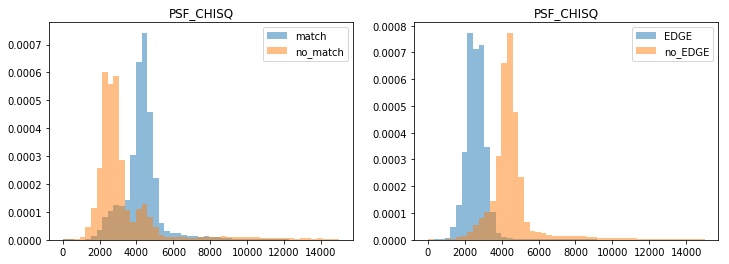

In [0]:
features = ['PSF_CHISQ']
fig,ax =  plt.subplots(1,2,figsize=(12,4))
EDA_1D(features,bins= np.linspace(0,15000,num=50),axis=ax[0],hdus=hdus)
EDA_1D(features,bins= np.linspace(0,15000,num=50),label='EDGE',axis=ax[1],hdus=hdus)

We see a similar situation to the above in many of the other parameters. There is generally a difference in the distributions for 'MATCH' vs 'NO MATCH' and 'EDGE' vs 'NO EDGE'.

Some of the parameters more naturally represented in 2D, we investigate these appropriately. Consider some of these shown below.

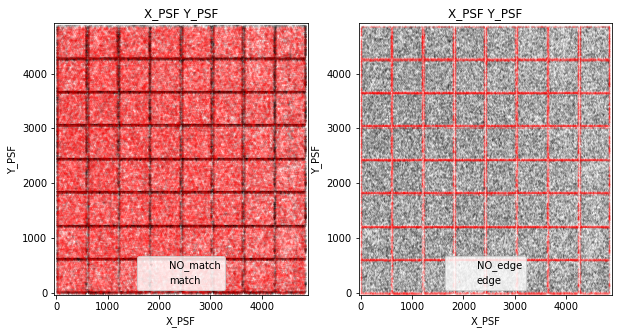

In [0]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
EDA_2D(['X_PSF','Y_PSF'],axis=ax[0],xlim=[-40,4900],ylim=[-40,4920],
         sno=10,syes=10,alphano = 0.1,alphayes =0.1, hdus=hdus)
EDA_2D(['X_PSF','Y_PSF'],label='edge', axis=ax[1],xlim=[-40,4900],ylim=[-40,4920],
         sno=5,syes=5,alphano = 0.1,alphayes =0.1, hdus=hdus)

We see that there is a tendency for 'MATCH' objects to lie within chip cells and 'NO MATCH' objects to lie on the edge of chip cells. We confirm this by comparing the plot on the left with the one on the right showing the edges on the chip cells (compare position of 'EDGE' vs. 'NO EDGE' objects).

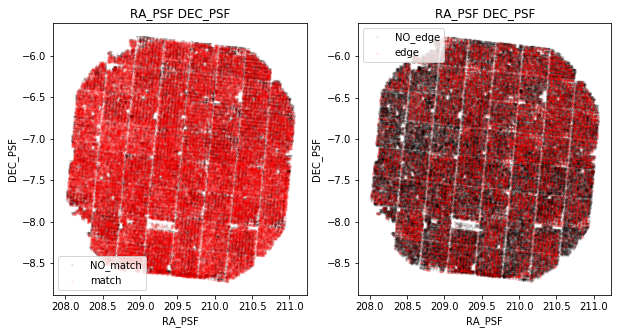

In [0]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
EDA_2D(['RA_PSF','DEC_PSF'],axis=ax[0],
          sno=10,syes=10,alphano = 0.1,alphayes =0.1, hdus=hdus)
EDA_2D(['RA_PSF','DEC_PSF'],label='edge', axis=ax[1],
         sno=10,syes=10,alphano = 0.1,alphayes =0.1, hdus=hdus)
plt.show()

We also see this clearly when considering the distributions of detections on the level of a RA-DEC plot. To see this more clearly, consider a zoom-in of the previous plot below.

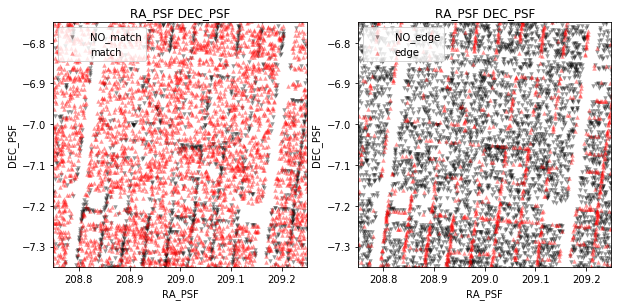

In [0]:
fig,ax = plt.subplots(1,2,figsize=(10,4.5))
EDA_2D(['RA_PSF','DEC_PSF'],xlim=[208.75,209.25],ylim=[-7.35,-6.75],
          sno=20,syes=20,alphano = 0.4,alphayes =0.4,axis=ax[0], hdus=hdus)
EDA_2D(['RA_PSF','DEC_PSF'],xlim=[208.75,209.25],ylim=[-7.35,-6.75],
         label='edge', axis=ax[1], sno=20,syes=20,alphano = 0.4,
         alphayes =0.4, hdus=hdus)

Notice again that the tendency for 'MATCH' objects to land within chip cells and the tendency for 'NO MATCH' objects to land on the edge of chip cells. We also investigate other parameters that are naturally represented in 2 dimensions such as MOMENTS_XX and MOMENTS_YY or X_PSF_SIG and Y_PSF_SIG. Notice how these parameters show different structures in the parameter space for real versus bogus detections.

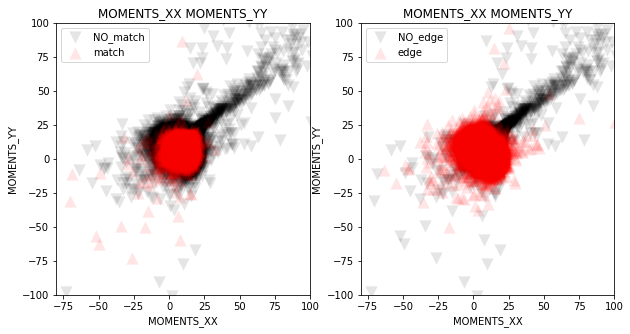

In [0]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
EDA_2D(['MOMENTS_XX','MOMENTS_YY'],axis=ax[0],xlim=[-80,100],ylim=[-100,100],
         sno=150,syes=150,alphano = 0.1,alphayes =0.1, hdus=hdus)
EDA_2D(['MOMENTS_XX','MOMENTS_YY'],label='edge', axis=ax[1],
         xlim=[-80,100],ylim=[-100,100], sno=150,syes=150,alphano = 0.1,alphayes =0.1,
         hdus=hdus)

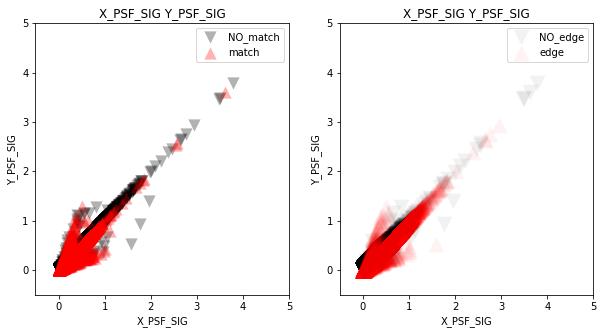

In [0]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
EDA_2D(['X_PSF_SIG','Y_PSF_SIG'],axis=ax[0],  xlim=[-.5,5],ylim=[-0.5,5],
          sno=150,syes=150,alphano = 0.3,alphayes =0.3, hdus=hdus)
EDA_2D(['X_PSF_SIG','Y_PSF_SIG'],label='edge', axis=ax[1],
         xlim=[-.5,5],ylim=[-0.5,5], sno=250,syes=250,alphano = 0.051,alphayes =0.051,
         hdus=hdus)

Unfortunately, while these features demonstrate some degree of seperation between 'MATCH' and 'NO MATCH' objects, they are highly correlated. Consider the pairwise correlation between features below.

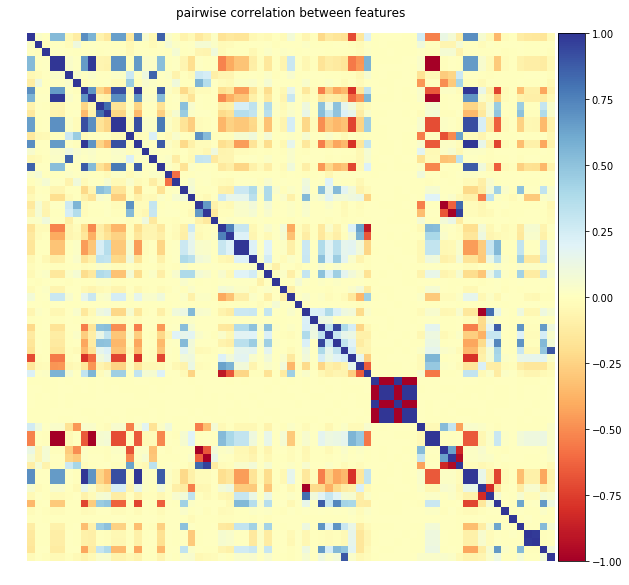

In [0]:
df_concat = []
for chip in chips:
    df_concat.append(read_chip(chip, hdus, False))    

df = pd.concat(list(df_concat), ignore_index=True)
corr = df.corr()
corr = corr.dropna(axis=0, how='all')
corr = corr.dropna(axis=1, how='all')


plt.figure(figsize=(10,10))
ax = plt.gca()
im = ax.imshow(corr, cmap='RdYlBu')
plt.title('pairwise correlation between features', y=1.02)
plt.axis('off')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)
plt.show()

Notice how the features are highly correlated with each other.

**To sum up, we show that 'MATCH' objects share certain properties in the feature space that differentiate them from 'NO MATCH' objects. We face the problem of high correlation between features while could be a problem down the line when trying to interpret the results of supervised learning.**

**Either way, the results from the EDA seem sufficiently promising, and we will proceed with supervised methods for the task.**

## 5. Supervised learning

We considered several supervised learning methods. We intend to cover the following methods:

1. Linear Classifiers (Logistic Regression, Support Vector Classification)
2. Ensembles (AdaBoost, Bagging)
3. Neural Networks (Dense Networks)

We choose not to consider decision trees as these were already experimented on for this dataset per the tutorial 2 notebook.

#### Proportion of 'MATCH' and 'NO MATCH' Objects

We demonstrate that these methods are able to reach a sufficient level of performance in predicting the catalog labels. First let us begin by noting one of the challenges with this dataset. Consider below the ratios of 'MATCH' and 'NO MATCH' objects on a chip by chip basis.

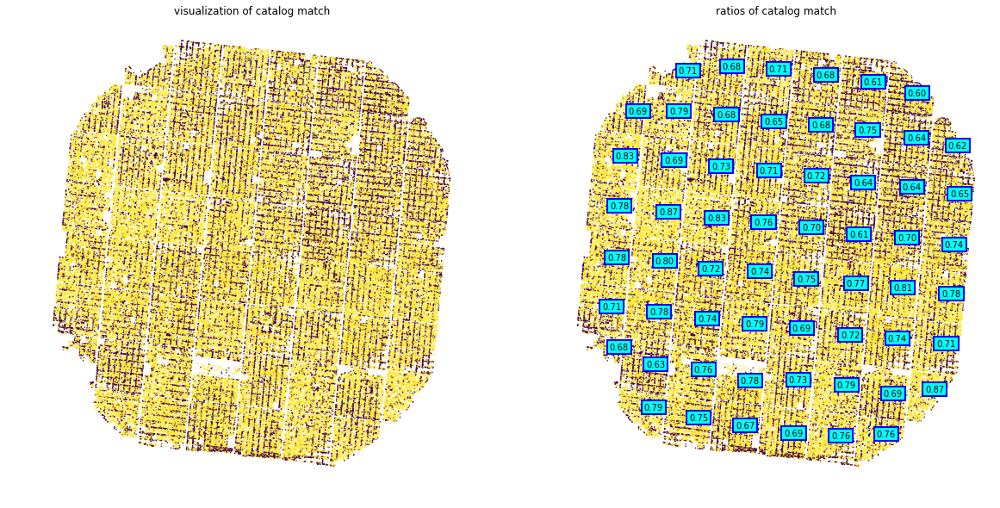

In [0]:
plt.figure(figsize=(20, 10))
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
plt.tight_layout()

for chip in chips:
    plt.subplot(1, 2, 1)
    df = df_dict[chip]
    plt.scatter(df['RA_PSF'], df['DEC_PSF'], c=df['MATCH'], s=0.3)    
    plt.title('visualization of catalog match')
    plt.axis('off')
    
match_ratios = []
for chip in chips:
    plt.subplot(1, 2, 2)
    df = df_dict[chip]
    plt.scatter(df['RA_PSF'], df['DEC_PSF'], c=df['MATCH'], s=0.3)
    plt.annotate("%0.2f"%(np.sum(df['MATCH']) / len(df['MATCH'])),(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props)
    match_ratios.append(np.sum(df['MATCH']) / len(df['MATCH']))
    plt.title('ratios of catalog match')
    plt.axis('off')

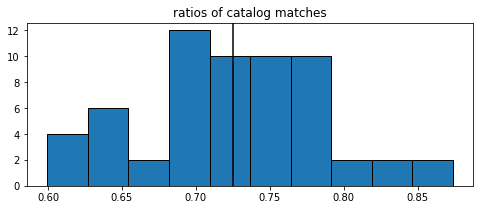

In [0]:
fig = plt.figure(figsize=(8,3))
plt.hist(match_ratios, edgecolor='k', bins=10)
plt.axvline(x=np.average(match_ratios), c='k')
plt.title('ratios of catalog matches')
plt.show()

Notice that the majority of detections within a chip (about 73% on average) are 'MATCH' objects. This imbalance in the dataset could lead to performance issues with the supervised methods. There are several ways to tackle this, such as upsampling the 'NO MATCH' objects in the dataset to balance the ratios. For most of the supervised methods (all except neural networks), we choose to tackle this by adjusting a weight associated with each class such that the weights are inversely proportional to class frequencies.

#### Metrics & Random Classifier Baseline

To get a sense for the difficulty of the labelling task, we being with a random classifier baseline. Given the expected ratio of 'MATCH' objects, we randomly assign labels keeping the same proportion of 'MATCH' objects. To measure the performance on this task, we propose two metrics:

1. True Negative Rate

Based on input from the module leaders, we propose a successful classifier as one that is able to retrieve 70-80% of the 'NO MATCH' objects. This corresponds to a true negative rate of 0.7-0.8.

2. False Negative Rate

Based on input from the module leaders, we propose a successful classifier as one that is able to misclassify fewer than 10% of the 'MATCH' objects. This corresponds to a false negative rate of < 0.1.

Notice that the two metrics 'compete' with each other. By setting up the task in this manner, we prevent trivial nonsensical solutions (such as 100% recall just by predicting the entire chip as 'MATCH' objects, etc.).

We evaluate the performance of the random baseline classifier on these two metrics.

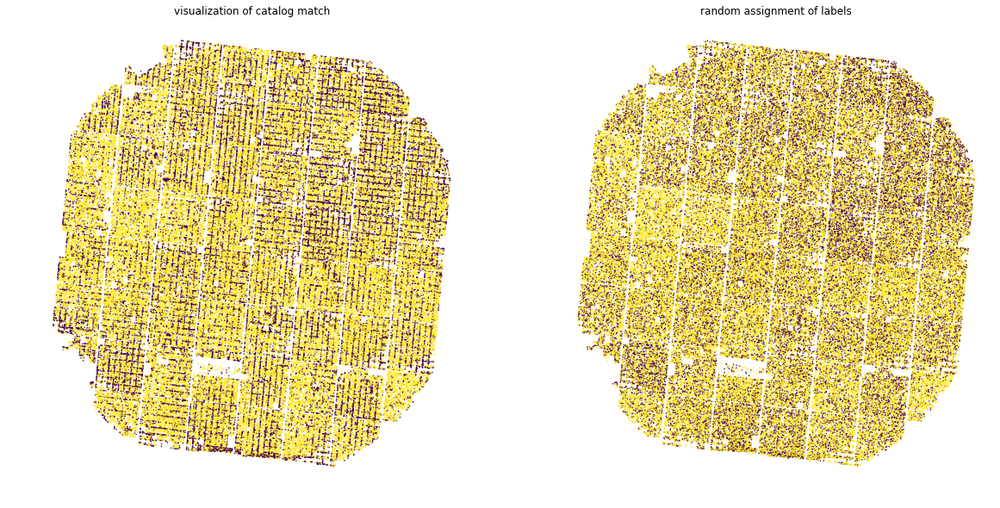

In [0]:
plt.figure(figsize=(20, 10))
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
plt.tight_layout()

for chip in chips:
    plt.subplot(1, 2, 1)
    df = df_dict[chip]
    plt.scatter(df['RA_PSF'], df['DEC_PSF'], c=df['MATCH'], s=0.3)    
    plt.title('visualization of catalog match')
    plt.axis('off')
    
for chip in chips:
    plt.subplot(1, 2, 2)
    df = df_dict[chip]
    plt.scatter(df['RA_PSF'], df['DEC_PSF'], c=random_classifier(np.sum(df['MATCH']), len(df['MATCH'])), s=0.3)
    plt.title('random assignment of labels')
    plt.axis('off')

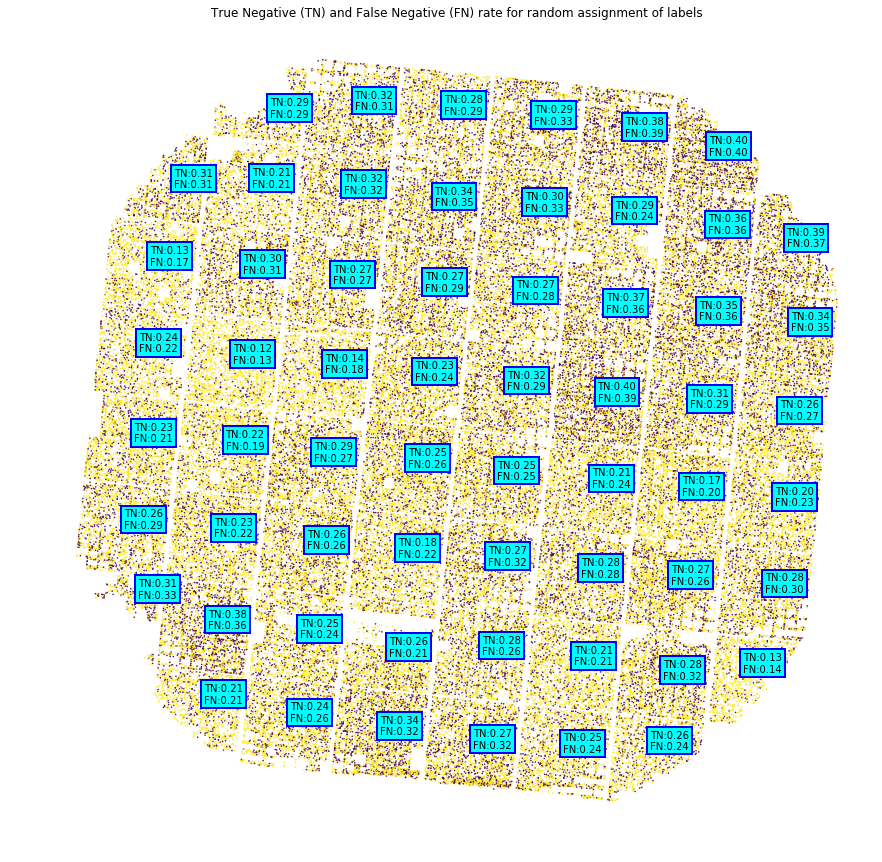

In [0]:
plt.figure(figsize=(15, 15))
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
plt.tight_layout()

true_negative_rates = []
false_negative_rates = []
for chip in chips:
    df = df_dict[chip]
    random_labels = random_classifier(np.sum(df['MATCH']), len(df['MATCH']))
    plt.scatter(df['RA_PSF'], df['DEC_PSF'], c=random_labels, s=0.3)
    
    cm = confusion_matrix(y_true=df['MATCH'], y_pred=random_labels)
    TN = (cm[0,0]) / (cm[0,0] + cm[0,1]) #true negative
    FN = (cm[1,0]) / (cm[1,0] + cm[1,1]) #false negative
    
    true_negative_rates.append(TN)
    false_negative_rates.append(FN)
    
    plt.annotate("TN:{0:.2f}\nFN:{1:.2f}".format(TN, FN) ,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )
    plt.title('True Negative (TN) and False Negative (FN) rate for random assignment of labels')
    plt.axis('off')

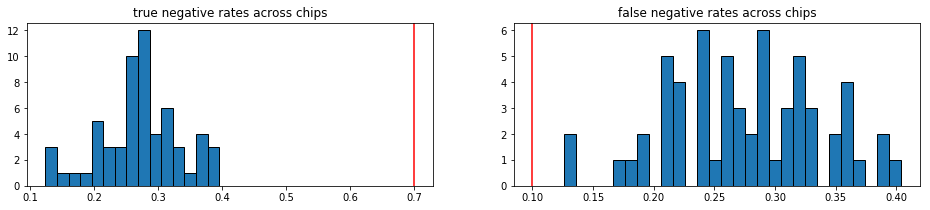

In [0]:
fig = plt.figure(figsize=(16, 3))

plt.subplot(1, 2, 1)
plt.hist(true_negative_rates, edgecolor='k', bins=15)
plt.axvline(x=0.7, c='r')
plt.title('true negative rates across chips')

plt.subplot(1, 2, 2)
plt.hist(false_negative_rates, edgecolor='k', bins=28)
plt.axvline(x=0.1, c='r')
plt.title('false negative rates across chips')

plt.show()

Notice that the random classifier fails on the task. 

1. We can see visually that the 'NO MATCH' objects do not lie preferably on the edges of the chip cells.
2. The metrics for the classifier do not come close to the proposed ranges for a successful classifier.

Notice that the classifier is much closer to the false negative target compared the the true negative target. This is likely because of the prevelance of the 'MATCH' objects compared to the 'NO MATCH' objects. Given the nature of the task, we assign more weight to the threshold for the false negative rates as we believe matches to the catalog to be very likely to be true.

#### Feature Selection

Given the large number of potential features in the dataset, we propose to use an automated feature selection method. We dump a logistic regression with L1 regularization on all the features to accomplish this.

In [0]:
labels_plot = []
coordinates_plot = []

true_negative_rates = []
false_negative_rates = []

test_size = 0.2
train_test_state = 0

suggested_cols = {}
for chip in chips:        
    df = read_chip(chip, hdus, False)
    
    col_candidates = [i.strip() for i in df.columns]
    df = df[col_candidates]
    df.dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    
    X = df
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    X_columns = X.columns
    y = df['MATCH']
    
    coordinates_plot.append(X)
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=train_test_state, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = LogisticRegression(penalty = 'l1', C = 2.0, n_jobs = -1, class_weight = 'balanced').fit(X_train, y_train)    
    
    select_model = SelectFromModel(model, prefit=True, max_features=10)    
    for i in X_columns[select_model.get_support()]:
        if i in suggested_cols:
            suggested_cols[i] += 1
        else:
            suggested_cols[i] = 1
    
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
 
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    labels_plot.append(model.predict(X))

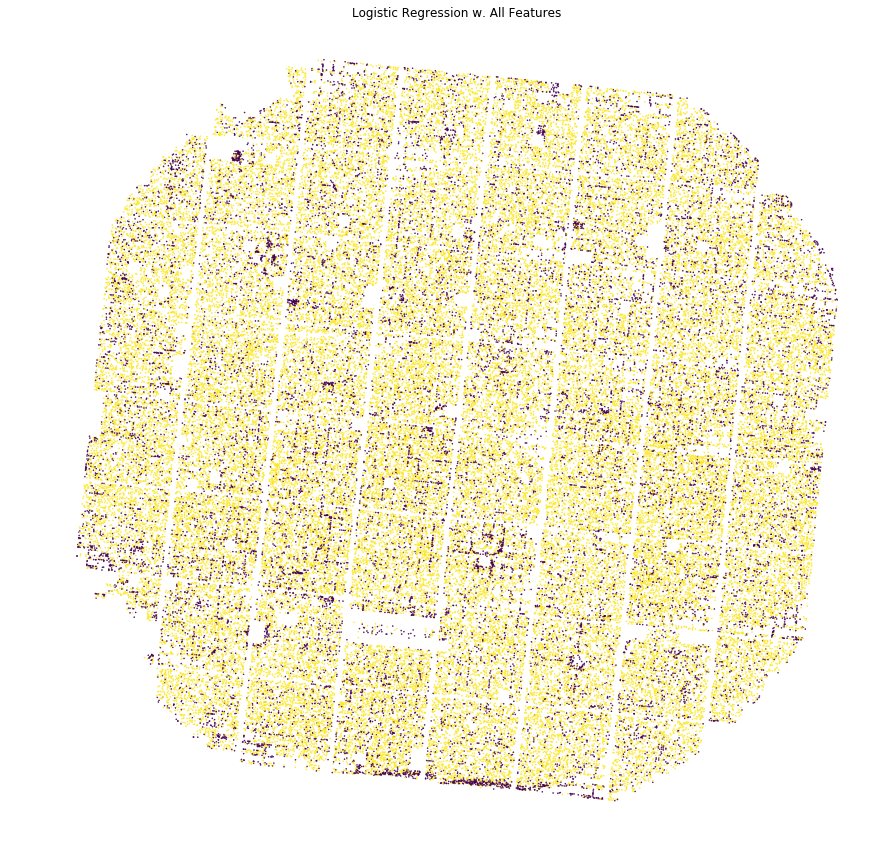

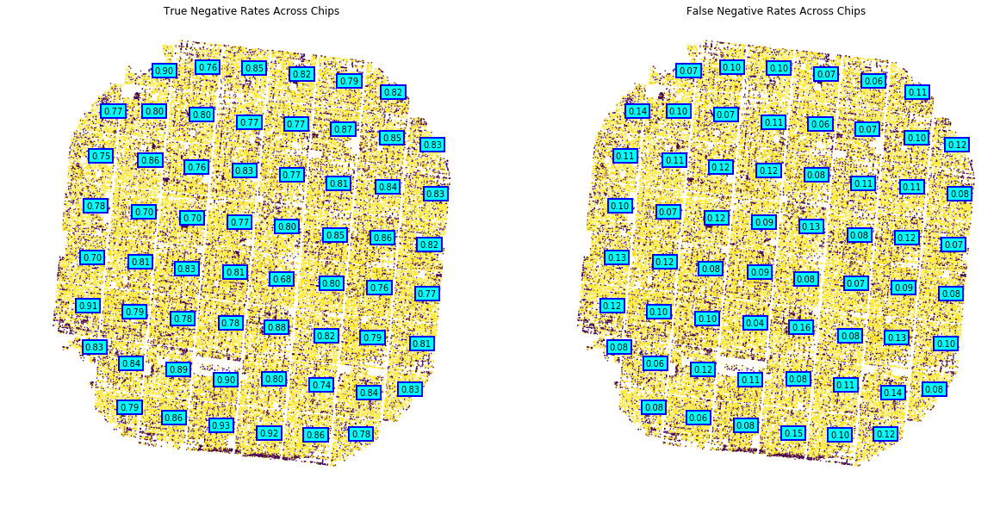

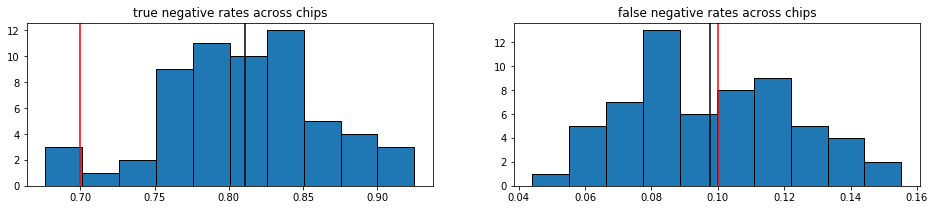

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'Logistic Regression w. All Features')

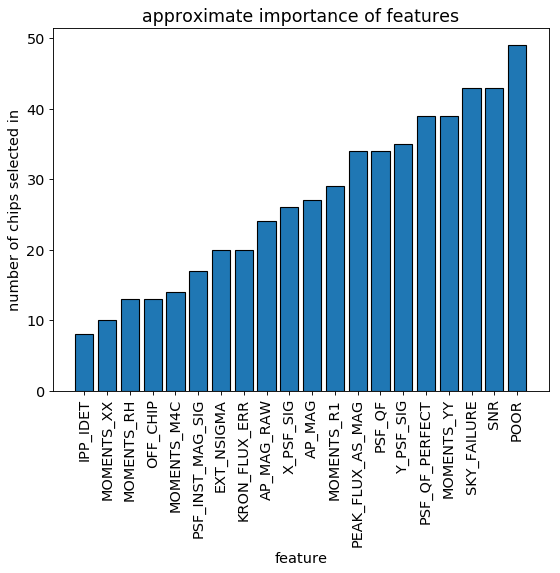

In [0]:
keep_n = 20
suggedted_cols_sorted = sorted(suggested_cols.items(), key=operator.itemgetter(1), reverse=True)
tplot = [(i[0],i[1]) for i in suggedted_cols_sorted[:keep_n]][::-1]
plt.rcParams.update({'font.size': 13})
_ =plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
_ = plt.bar([i[0] for i in tplot], [i[1] for i in tplot], orientation = 'vertical', edgecolor='k')
_ = plt.xticks(rotation=90)
plt.xlabel('feature')
plt.ylabel('number of chips selected in')
plt.title('approximate importance of features')
plt.show()

From this, we retieve the features that were determined to be the most important across the chips. Notice here the similarity between our most importance features and those that were determined by a random forest classifier in notebook 2 reproduced below:

1. PSF_QF_PERFECT
2. SNR
3. CR_LIMIT
4. PSF_THETA
5. SKY
6. X_PSF
7. X_PSF_SIG
8. Y_PSF
9. Y_PSF_SIG
10. EXT_LIMIT
11. NONLINEAR_FIT
12. PASS1_SRC

This gives us confidence that in this classification task, the features determined by our method are indeed significant. Additionally, we also consider interaction terms and terms up to power 2, again by employing logistc regression with L1 regularization.

In [0]:
coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []

suggested_cols_composite = {}

for chip in chips:

    df = read_chip(chip, hdus, False)
    col_candidates = [i.strip() for i in df.columns]
    df = df[col_candidates]
    df.dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    
    X = df
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    X_columns = X.columns
    y = df['MATCH']
    
    coordinates_plot.append(X)
    
    poly = PolynomialFeatures(2)
    X = poly.fit_transform(X)

    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = LogisticRegression(penalty = 'l1', C = 2.0, n_jobs = -1, class_weight = 'balanced').fit(X_train, y_train)
    
    select_model = SelectFromModel(model, prefit=True, max_features=10)
    
    X_columns = np.array(poly.get_feature_names(X_columns))
    for i in X_columns[select_model.get_support()]:
        if i in suggested_cols_composite:
            suggested_cols_composite[i] += 1
        else:
            suggested_cols_composite[i] = 1
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

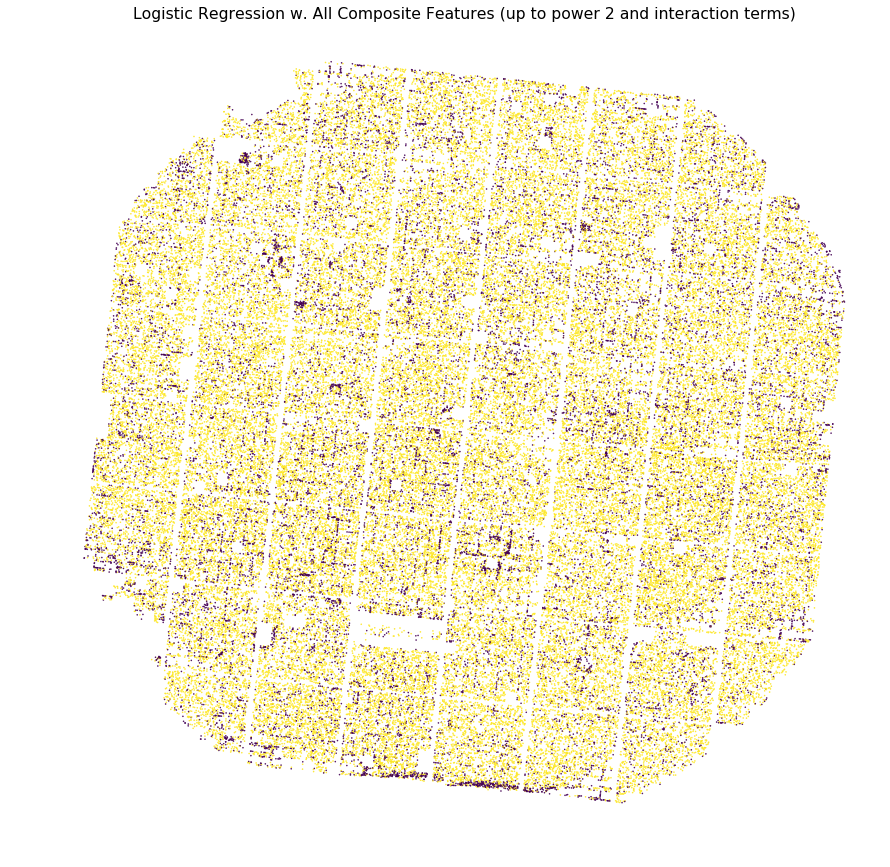

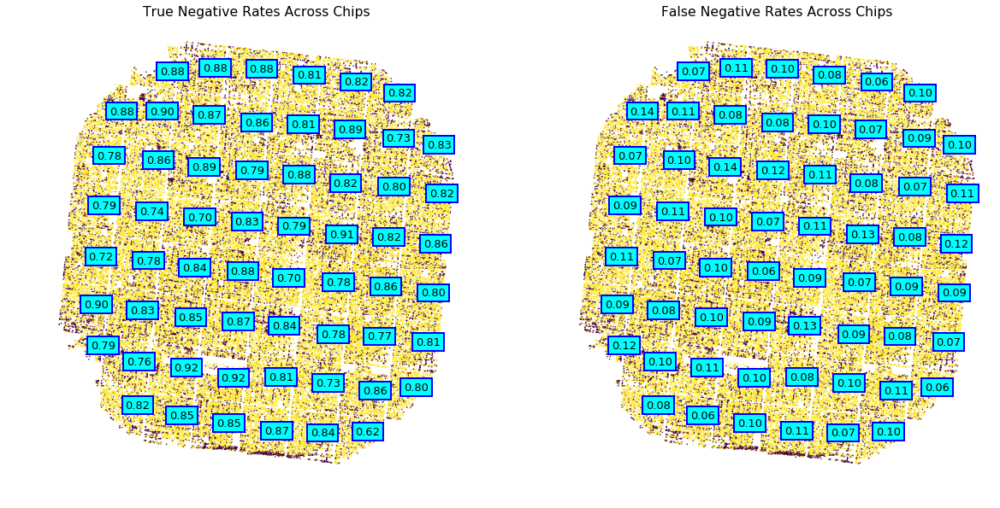

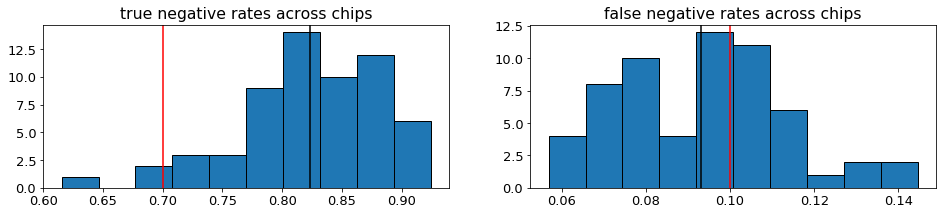

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'Logistic Regression w. All Composite Features (up to power 2 and interaction terms)')

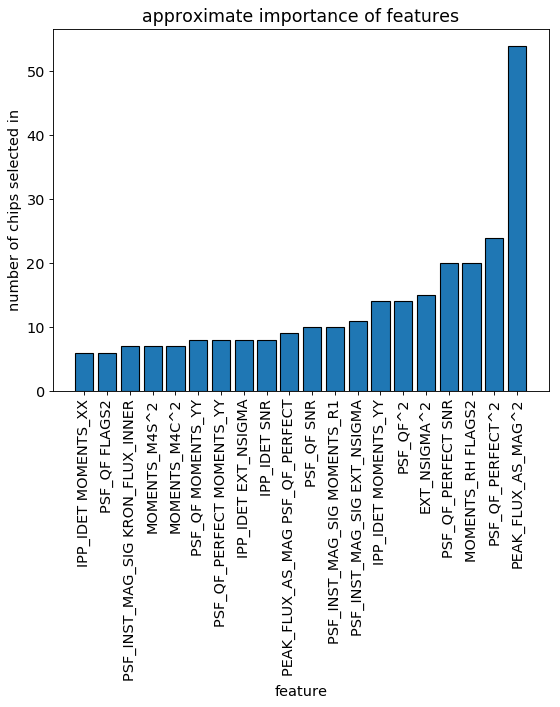

In [0]:
suggested_cols_composite_sorted = sorted(suggested_cols_composite.items(), key=operator.itemgetter(1), reverse=True)
keep_n = 20
tplot = [(i[0],i[1]) for i in suggested_cols_composite_sorted[:keep_n]][::-1]

plt.rcParams.update({'font.size': 13})
_ =plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
_ = plt.bar([i[0] for i in tplot], [i[1] for i in tplot], orientation = 'vertical', edgecolor='k')
_ = plt.xticks(rotation=90)
plt.xlabel('feature')
plt.ylabel('number of chips selected in')
plt.title('approximate importance of features')
plt.show()

From this, as before, we obtain the most important interaction and power 2 terms across the chips. We will choose to use the top 19 linear features and top 19 interaction and power 2 terms. Below, we double check the pairwise correlation between our selected features.

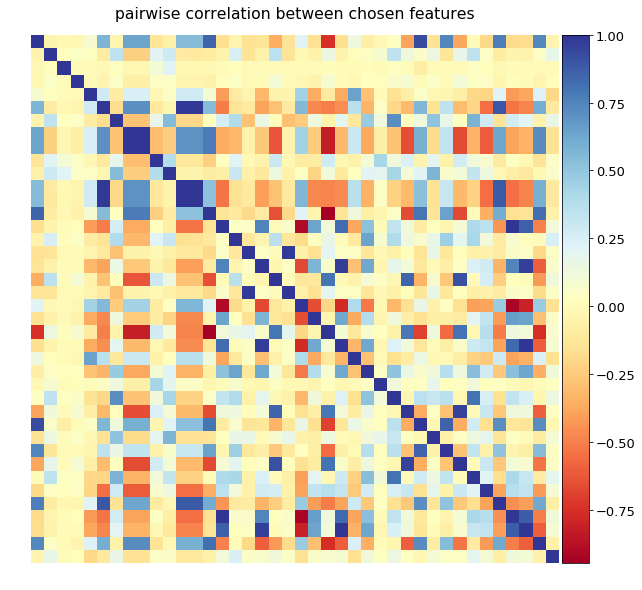

In [0]:
Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

df = pd.concat(list(df_dict.values()), ignore_index=True)
df = df[Xcol_list]
corr = df.corr()
corr = corr.dropna(axis=0, how='all')
corr = corr.dropna(axis=1, how='all')


plt.figure(figsize=(10,10))
ax = plt.gca()
im = ax.imshow(corr, cmap='RdYlBu')
plt.title('pairwise correlation between chosen features', y=1.02)
plt.axis('off')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)
plt.show()

We see that while the selected features do not exhibit the same extreme degree of correlation, they are still quite correlated. We will proceed with these features as is. However, if we intend to do further studies in deconstructing how a learned supervised classifier identifes a detection as real or bogus, it would be useful to revisit feature selection to select features that are not as correlated.

We will proceed with supervised methods trained on a chip by chip basis, unless otherwise stated. This is to reflect the fact that each chip behaves slightly differently. An alternative to this could have been to one-hot encode the chip ID. 

#### Logistic Regression

We begin by using logistic regression with L2 regularization for the classification task. Logistic regression provides a probability for a data point to belong to either class based on a set threshold.

Given a feature vector $X$ and weight vector $W$, 

$$ sigmoid(z) = \frac{1}{1 + e^{-WX + B}} $$

We employ log likelihood and gradient descent in combination for optimization with a L1 or L2 regularized cost function. We also weight the cost function to reflect the prevelance of 'MATCH' and 'NO MATCH' objects in our data.

In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']


coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []


for chip in chips:
    df = df_dict[chip]
    
    df = df[col_list].dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    coordinates_plot.append(df)

    X = df[Xcol_list]
    y = df['MATCH']
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    
    
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = LogisticRegression(penalty = 'l2', C = 2.0, n_jobs = -1, class_weight = 'balanced').fit(X_train, y_train)
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

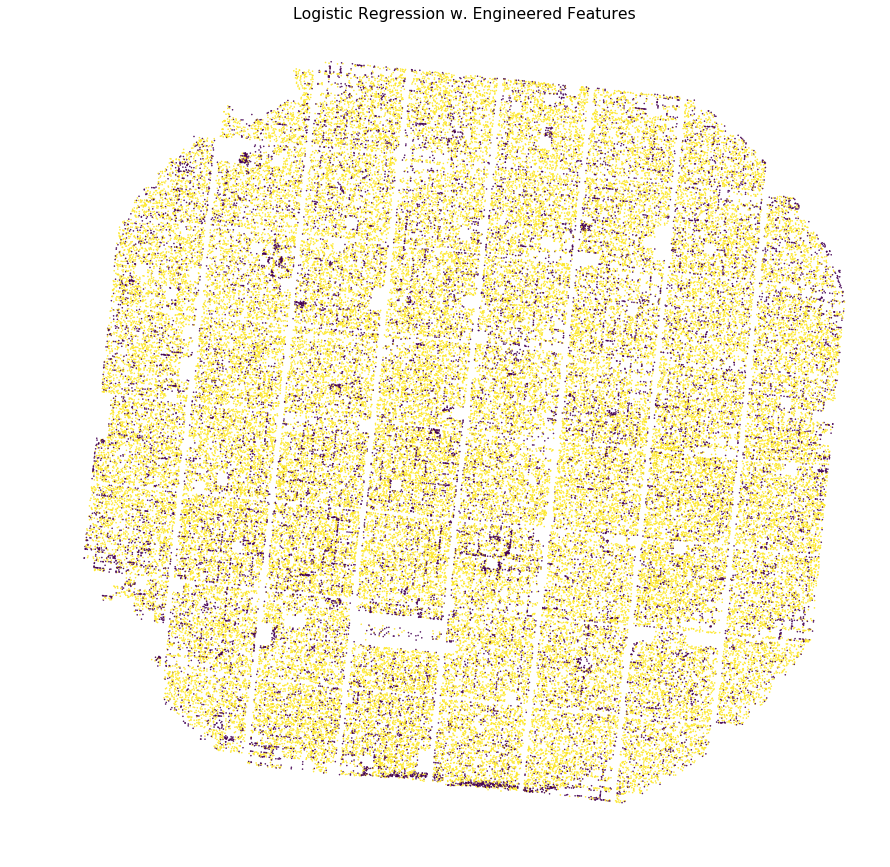

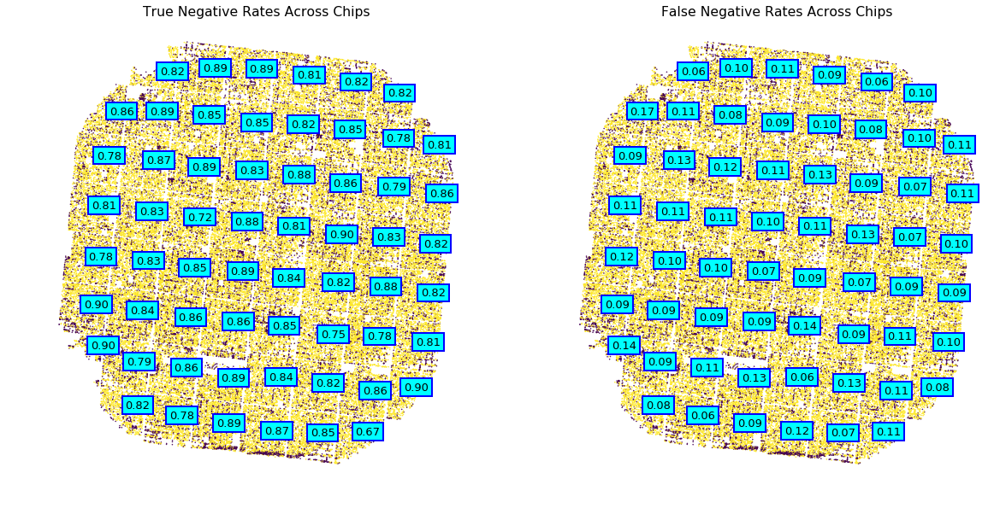

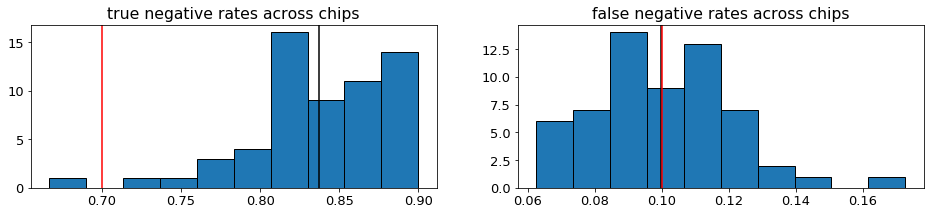

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'Logistic Regression w. Engineered Features')

Notice that the simple logistic classifier performs fairly well on the task.

1. We can see visually that most of the 'NO MATCH' objects line up nicely on edges of the chip cells.
2. The true negative rate beats the threshold that we're willing to accept and the false negative rate is on our threshold.

It is quite surprising that a method as simple as the logistic classifier is able to achieve this performance. Additionally, we also evaluated a support vector classifier (SVC). We expect that the SVC might perform slightly better as it seeks to guarantee a decision boundary that is equi-distant between points from either class.

# Support Vector Classifier (SVC)

The support vector classifier determines a decision boundary in the feature space that best seperates the data into two classes. We apply the standard kernel tricks. Again as before, we modify the cost function to reflect the prevalance of 'MATCH' and 'NO MATCH' objects in our data.

In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']


coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []


for chip in chips:
    df = df_dict[chip]
    
    df = df[col_list].dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    coordinates_plot.append(df)

    X = df[Xcol_list]
    y = df['MATCH']
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    
    
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = SVC(C = 0.9, class_weight = 'balanced', decision_function_shape = 'ovo').fit(X_train, y_train)
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

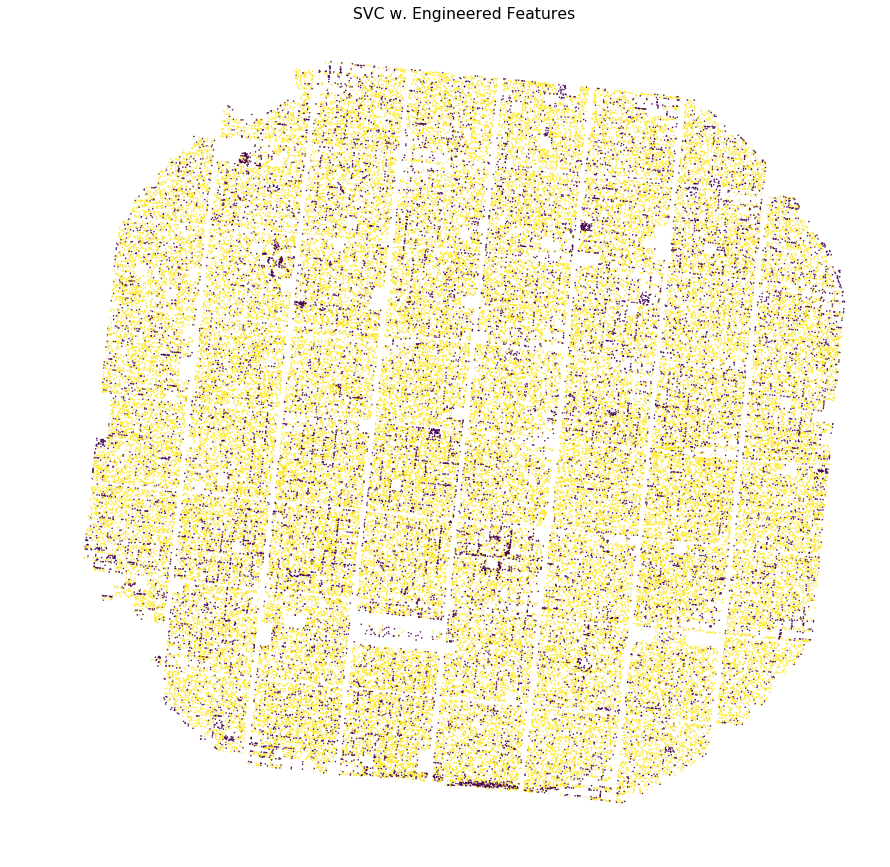

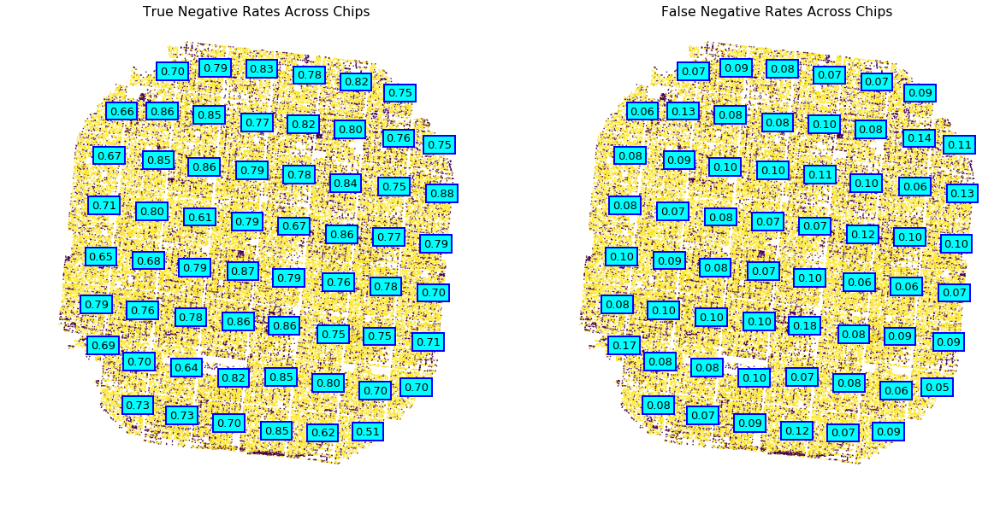

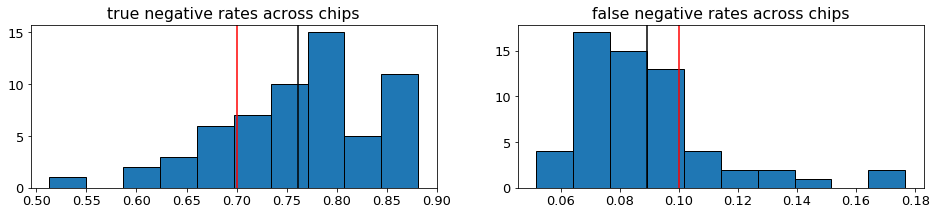

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'SVC w. Engineered Features')

Again, we notice that the SVC classifier peforms fairly well on the task.

1. We see 'NO MATCH' objects falling on the edges of chip cells. 
2. The true negative rates and false negative rates across the chips beats our thresholds with comfortable margins.

The SVC performs better than the logistic classifier. It is hard to draw direct comparisons between the two methods, so we will not guess why one performs better than the other. A natural progression from these individual linear classifiers was to employ an ensemble of these classifiers to improve their performance. We considered both AdaBoost and Bagging.

#### AdaBoost

AdaBoost employs an ensemble of classifiers with different weights. The ensemble $F$ is constructed iteratively, where the weight $\theta$ for each data point is updated based on the performance of the previous classifiers $f_{0, 1, ...,  m-1}$ in the ensemble on that data point. The ensemble classifier can be summarised as:

$$ F(x) = \sum_m \theta_m  f_m(x)$$

In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']


coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []


for chip in chips:
    df = df_dict[chip]
    
    df = df[col_list].dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    coordinates_plot.append(df)

    X = df[Xcol_list]
    y = df['MATCH']
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    
    
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = LogisticRegression(penalty = 'l2', C = 2.0, n_jobs = -1, class_weight = 'balanced')
    model = AdaBoostClassifier(base_estimator=model, n_estimators=50, learning_rate=1.).fit(X_train, y_train)
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

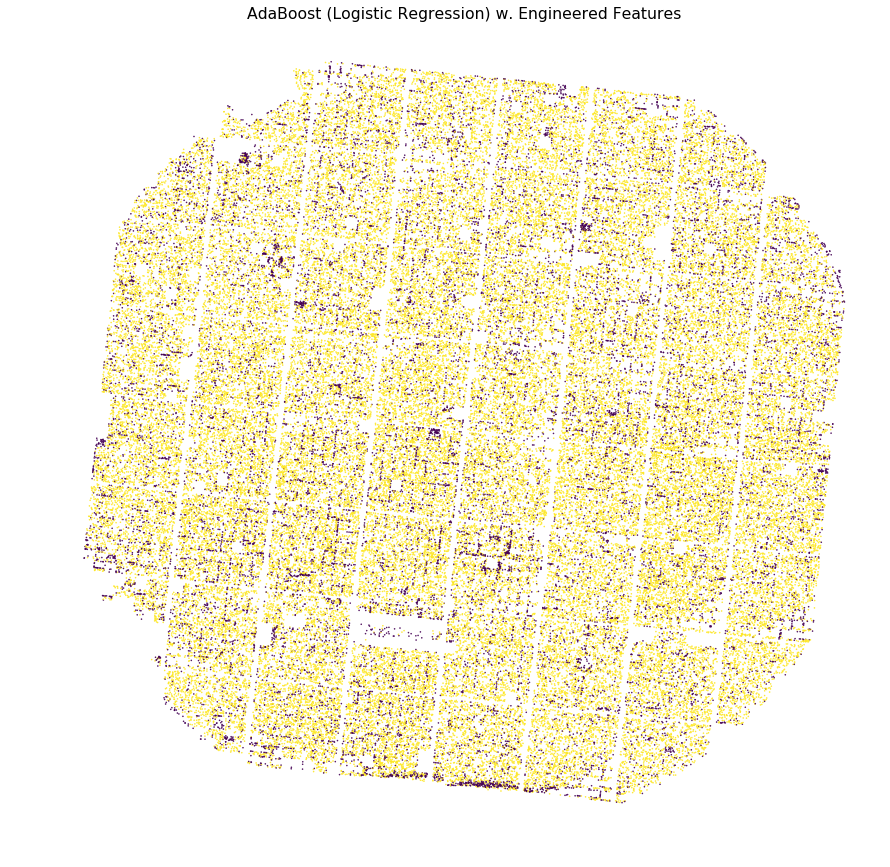

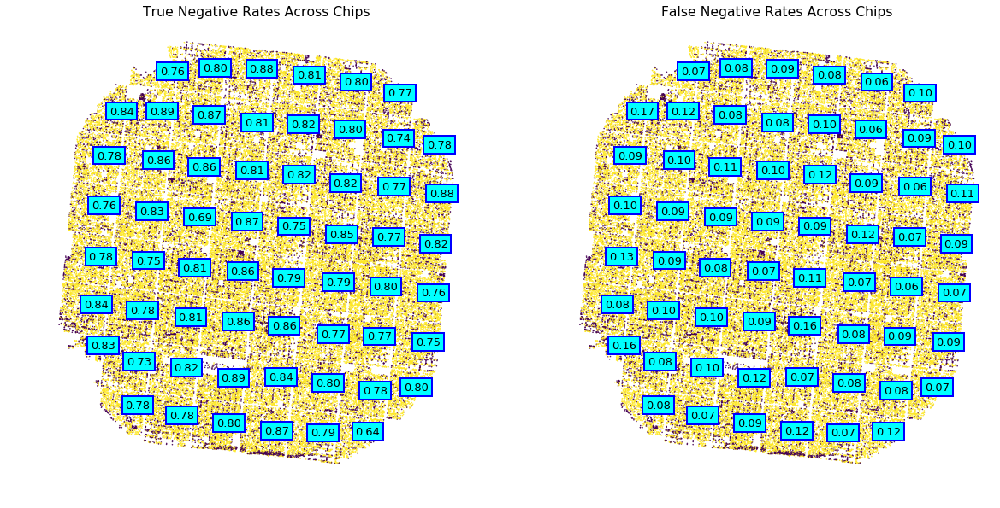

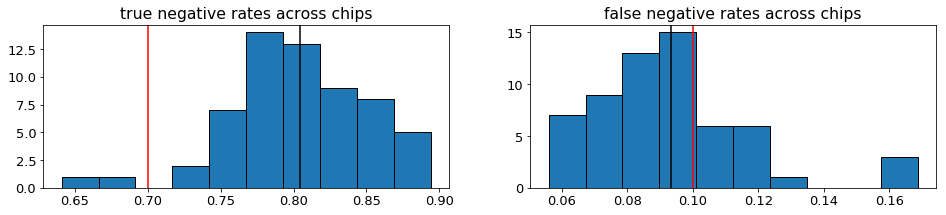

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'AdaBoost (Logistic Regression) w. Engineered Features')

AdaBoost with Logistic Regressors performs fairly well on the task.

We see that there is not a significant change in the performance of the logistic classifier with AdaBoost. We trade off a lower true negative rate for a lower false negative rate. SVC is not suited for AdaBoost and the classification is done based on distance to nearest points between the two classes, there is no probability associated with the classification. 

#### Bagging

We next considered the bagging ensemble method for logistic regression and SVC classifiers. In bagging, we combine an ensemble of models trained on bootstrapped samples of the training data.

In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']


coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []


for chip in chips:
    df = df_dict[chip]
    
    df = df[col_list].dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    coordinates_plot.append(df)

    X = df[Xcol_list]
    y = df['MATCH']
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    
    
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = LogisticRegression(penalty = 'l2', C = 2.0, n_jobs = -1, class_weight = 'balanced')    
    model = BaggingClassifier(base_estimator=model, n_estimators=50, max_samples=1., max_features=5, bootstrap=False, bootstrap_features=False, oob_score=False, warm_start=False, n_jobs=-1, random_state=0, verbose=0).fit(X_train, y_train)
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

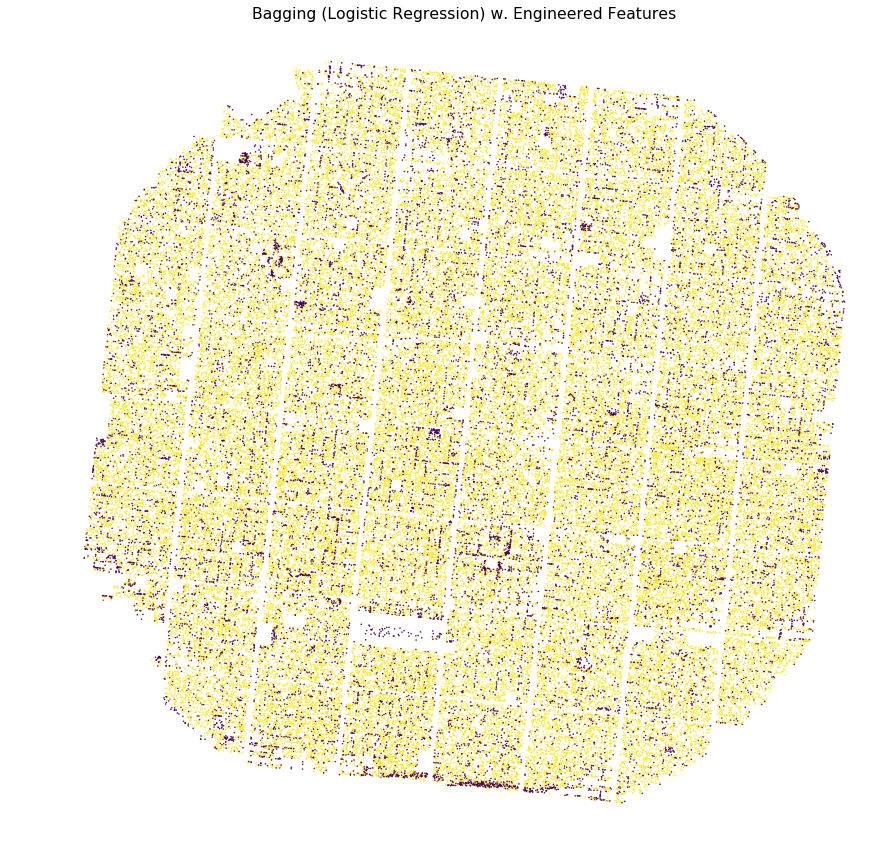

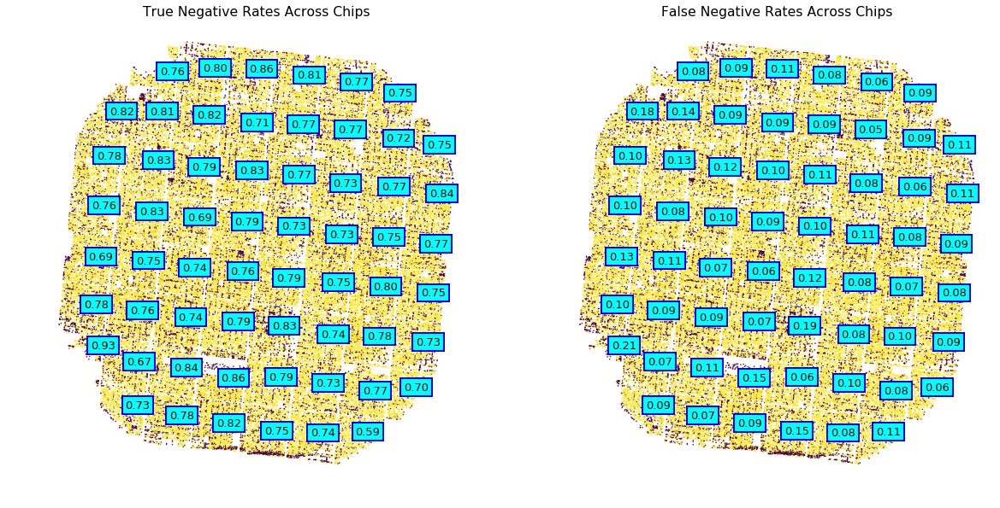

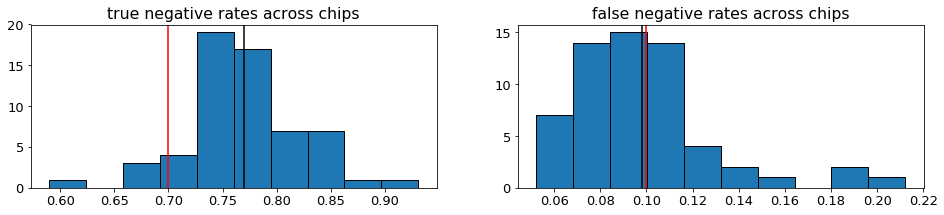

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'Bagging (Logistic Regression) w. Engineered Features')

Again, as was the case with AdaBoost, we see that employing a Bagging ensemble does not significantly affect the results. We see that compared to a standalone logistic regressor, the bagging classifier offers a slightly lower false negative rate for a lower true negative rate. We are willing to accept this tradeoff given our priorities for the true negative vs. false negative rates as described previously. This is our best classifier thus far. We also consider a bagging ensemble of SVC classifiers.

In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']


coordinates_plot = []
true_negative_rates = []
false_negative_rates = []
labels_plot = []


for chip in chips:
    df = df_dict[chip]
    
    df = df[col_list].dropna()
    df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
    coordinates_plot.append(df)

    X = df[Xcol_list]
    y = df['MATCH']
    X = X.drop(['EDGE', 'MATCH'], axis=1)
    
    
    
    min_max_scaler = preprocessing.MinMaxScaler()
    X = min_max_scaler.fit_transform(X)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
    y_train = y_train.astype(int)
    y_test = y_test.astype(int)
    
    model = SVC(C = 0.9, class_weight = 'balanced', decision_function_shape = 'ovo').fit(X_train, y_train)
    model = BaggingClassifier(base_estimator=model, n_estimators=50, max_samples=1., max_features=5, bootstrap=False, bootstrap_features=False, oob_score=False, warm_start=False, n_jobs=-1, random_state=0, verbose=0).fit(X_train, y_train)
    
    labels = model.predict(X_test)
    cm = confusion_matrix(y_true=y_test, y_pred=labels)
    
    true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
    false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))
    
    labels_plot.append(model.predict(X))    

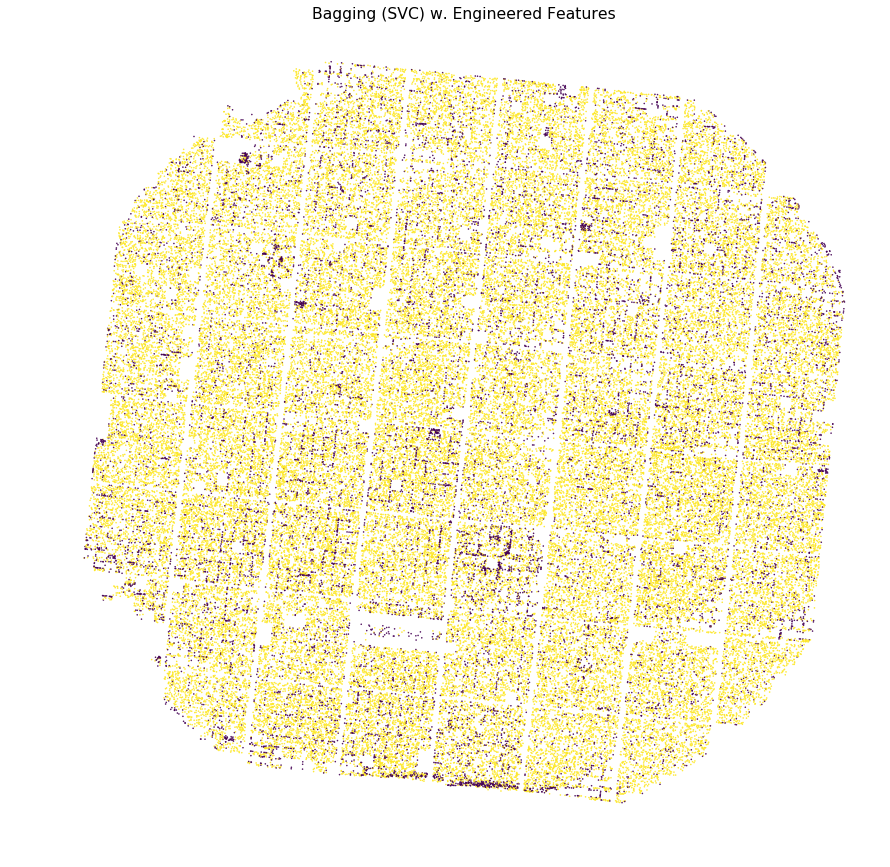

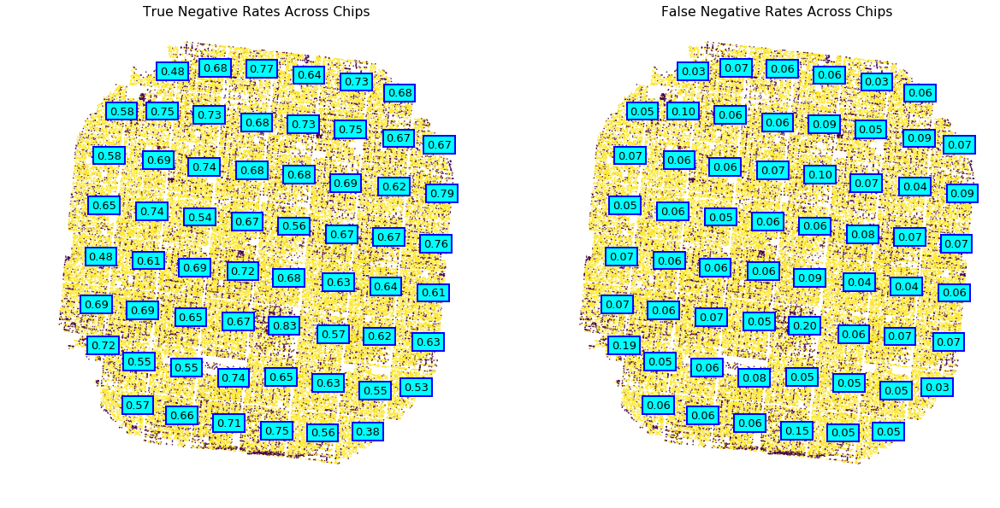

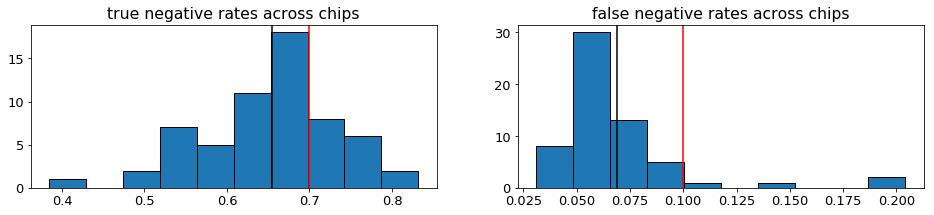

In [0]:
viz_rates(coordinates_plot, labels_plot, true_negative_rates, false_negative_rates, 'Bagging (SVC) w. Engineered Features')

We see that a bagging ensemble of SVC classifiers, as was the case of ensembles of logistic regressor classifiers, does not significantly affect the performance. We still see that the classifier performs decently, trading off a lower false negative rate for a lower true negative rate.

We then ran the best classifier thus far, a bagging ensemble of logistic regressors, on the full dataset.


In [0]:
col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

true_negative_rates = []
false_negative_rates = []

for smf_name, smf_file in tqdm(smf_store.items()):
    for chip in chips:
        df = read_chip(chip, smf_file, True)

        df = df[col_list].dropna()
        df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)

        X = df[Xcol_list]
        y = df['MATCH']
        X = X.drop(['EDGE', 'MATCH'], axis=1)

        min_max_scaler = preprocessing.MinMaxScaler()
        X = min_max_scaler.fit_transform(X)

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, stratify=y)
        y_train = y_train.astype(int)
        y_test = y_test.astype(int)

        model = LogisticRegression(penalty = 'l2', C = 2.0, n_jobs = -1, class_weight = 'balanced')    
        model = BaggingClassifier(base_estimator=model, n_estimators=50, max_samples=1., max_features=5, bootstrap=False, bootstrap_features=False, oob_score=False, warm_start=False, n_jobs=-1, random_state=0, verbose=0).fit(X_train, y_train)

        labels = model.predict(X_test)
        cm = confusion_matrix(y_true=y_test, y_pred=labels)

        true_negative_rates.append((cm[0,0]) / (cm[0,0] + cm[0,1]))
        false_negative_rates.append((cm[1,0]) / (cm[1,0] + cm[1,1]))

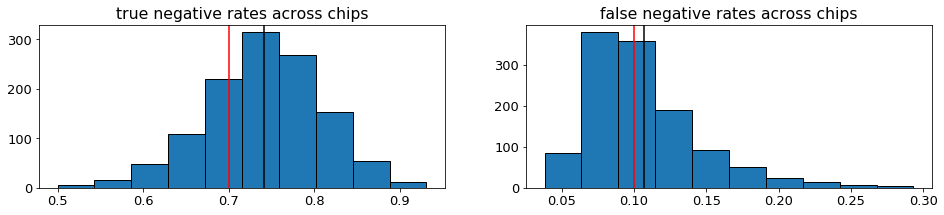

In [0]:
fig = plt.figure(figsize=(16, 3))

plt.subplot(1, 2, 1)
plt.hist(true_negative_rates, edgecolor='k')
plt.axvline(x=np.mean(true_negative_rates), c='k')
plt.axvline(x=0.7, c='r')
plt.title('true negative rates across chips')

plt.subplot(1, 2, 2)
plt.hist(false_negative_rates, edgecolor='k')
plt.axvline(x=np.mean(false_negative_rates), c='k')
plt.axvline(x=0.1, c='r')
plt.title('false negative rates across chips')

plt.show()

We see that we obtain acceptable, but not spectacular performance on the true negative and false negative rates across the chips. We see a fairly consistent performance on these metrics that beats our thresholds. 

#### Neural Network Classifiers

Next, we consider a dense neural network for the classification task. Notably, 

1. Instead of adjusting the weights for the different classes in the loss function to account for the imbalance in the dataset, we upsample the 'NO MATCH' objects in the dataset to balance their relative prevalance.

2. We train a single neural network to classify detections across all chips.

In [0]:
df_smfs = []

col_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA',
            'AP_MAG', 'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG',
            'PSF_QF', 'MOMENTS_YY', 'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'RA_PSF', 
            'DEC_PSF', 'PEAK_FLUX_AS_MAG_SQUARED', 'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 
            'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER', 'EXT_NSIGMA_x_IPP_IDET', 
            'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED', 'IPP_IDET_x_MOMENTS_YY', 
            'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET', 
            'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

Xcol_list = ['IPP_IDET', 'MOMENTS_XX', 'MOMENTS_RH', 'OFF_CHIP', 'MOMENTS_M4C', 'PSF_INST_MAG_SIG', 'EXT_NSIGMA', 'AP_MAG',
             'AP_MAG_RAW', 'KRON_FLUX_ERR', 'MOMENTS_R1', 'Y_PSF_SIG', 'X_PSF_SIG', 'PEAK_FLUX_AS_MAG', 'PSF_QF', 'MOMENTS_YY', 
             'SKY_FAILURE', 'PSF_QF_PERFECT', 'SNR', 'POOR', 'EDGE', 'MATCH', 'PEAK_FLUX_AS_MAG_SQUARED', 
             'PSF_QF_PERFECT_SQUARED', 'MOMENTS_M4C_SQUARED', 'PSF_QF_PERFECT_x_MOMENTS_YY', 'PST_INST_MAG_SIG_x_KRON_FLUX_INNER',
             'EXT_NSIGMA_x_IPP_IDET', 'PSF_QF_PERFECT_x_SNR', 'IPP_IDET_x_MOMENTS_R1', 'EXT_NSIGMA_SQUARED',
             'IPP_IDET_x_MOMENTS_YY', 'SNR_x_PSF_QF', 'PSF_INST_MAG_SIG_x_EXT_NSIGMA', 'SNR_x_IPP_IDET', 'PSF_INST_MAG_SIG_x_IPP_IDET',
             'PSF_QF_SQUARED', 'PSF_QF_PERFECT_x_PSF_QF', 'PSF_QF_PERFECT_x_PEAK_FLUX_AS_MAG', 'EXT_NSIGMA_x_MOMENTS_M4C']

for smf_name, smf_file in tqdm(smf_store.items()):  
    for chip in chips:
        df = read_chip(chip, smf_file, True)
        if df is None:
            print('{} does not have data for the chip {}.'.format(smf_name, chip))
            continue
        df = df[col_list].dropna()
        df = df.replace([np.inf, -np.inf], np.nan).dropna(axis = 0)
        
        df_smfs.append(df)

df_smfs = pd.concat(df_smfs, ignore_index=True)

In [0]:
df_smfs, df_smfs_val = train_test_split(df_smfs, test_size=0.1, random_state=42, stratify=df_smfs['MATCH'])

df_smfs_nomatch = df_smfs[df_smfs['MATCH'] == 0]
df_smfs_num_match = np.sum(df_smfs['MATCH'])
df_smfs_num_nomatch = len(df_smfs['MATCH']) - df_smfs_num_match

df_smfs_nomatch_upsamples = resample(df_smfs_nomatch, replace=True, n_samples=df_smfs_num_match - df_smfs_num_nomatch)
df_smfs = pd.concat([df_smfs, df_smfs_nomatch_upsamples], ignore_index=True)

X_train = df_smfs[Xcol_list]
X_train = X_train.drop(['EDGE', 'MATCH'], axis=1)

min_max_scaler = preprocessing.MinMaxScaler()
X_train = min_max_scaler.fit_transform(X_train)

y_train = df_smfs['MATCH']

X_test = df_smfs_val[Xcol_list]
X_test = X_test.drop(['EDGE', 'MATCH'], axis=1)

min_max_scaler = preprocessing.MinMaxScaler()
X_test = min_max_scaler.fit_transform(X_test)

y_test = df_smfs_val['MATCH']

y_train = y_train.astype(int)
y_test = y_test.astype(int)

y_train = OneHotEncoder().fit_transform(np.array(y_train).reshape(-1, 1))
y_test = OneHotEncoder().fit_transform(np.array(y_test).reshape(-1, 1))

In [0]:
net_in = keras.layers.Input(shape=X_train.shape[1:])
x = keras.layers.Dropout(0.2)(net_in)
x = keras.layers.Dense(256, activation='relu', kernel_regularizer=keras.regularizers.l2(1e-2))(net_in)
x = keras.layers.Dropout(0.35)(x)
x = keras.layers.Dense(128, activation='relu', kernel_regularizer=keras.regularizers.l2(1e-2))(x)
x = keras.layers.Dropout(0.2)(x)
x = keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(1e-2))(x)
x = keras.layers.Dropout(0.2)(x)
x = keras.layers.Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l2(1e-2))(x)
x = keras.layers.Dropout(0.2)(x)
x = keras.layers.Dense(16, activation='relu', kernel_regularizer=keras.regularizers.l2(1e-2))(x)
x = keras.layers.Dropout(0.5)(x)
net_out = keras.layers.Dense(2, activation='softmax', kernel_regularizer=keras.regularizers.l2(1e-2))(x)
FCN = keras.models.Model(inputs=net_in, outputs=net_out)
FCN.compile(optimizer=keras.optimizers.SGD(), loss='categorical_crossentropy', metrics=['accuracy'])
FCN_history = FCN.fit(X_train, y_train, batch_size=2048, epochs=10, validation_split=0.05, verbose=1, shuffle=True)

Train on 3611989 samples, validate on 190105 samples
Epoch 1/10
3611989/3611989 [==============================] - 42s 12us/step - loss: 3.4548 - acc: 0.6039 - val_loss: 2.6207 - val_acc: 0.5687
Epoch 2/10
3611989/3611989 [==============================] - 38s 11us/step - loss: 1.9936 - acc: 0.7415 - val_loss: 1.5824 - val_acc: 0.6269
Epoch 3/10
3611989/3611989 [==============================] - 39s 11us/step - loss: 1.2834 - acc: 0.7714 - val_loss: 1.0920 - val_acc: 0.6681
Epoch 4/10
3611989/3611989 [==============================] - 39s 11us/step - loss: 0.9360 - acc: 0.7814 - val_loss: 0.8489 - val_acc: 0.6799
Epoch 5/10
3611989/3611989 [==============================] - 38s 11us/step - loss: 0.7654 - acc: 0.7853 - val_loss: 0.7171 - val_acc: 0.6908
Epoch 6/10
3611989/3611989 [==============================] - 39s 11us/step - loss: 0.6813 - acc: 0.7868 - val_loss: 0.6658 - val_acc: 0.6875
Epoch 7/10
3611989/3611989 [==============================] - 39s 11us/step - loss: 0.6392 - ac

In [0]:
labels = FCN.predict(X_test, verbose=1, batch_size=2048)
cm = confusion_matrix(y_true=np.argmax(y_test, axis=1), y_pred=np.argmax(labels, axis=1))

true_negative_rates = (cm[0,0]) / (cm[0,0] + cm[0,1])
false_negative_rates = (cm[1,0]) / (cm[1,0] + cm[1,1])

242438/242438 [==============================] - 1s 2us/step


true negative rate (req. ~.7 - .8):   0.6662928548542134.
false negative (req. < 0.1): 0.07145832938814929.


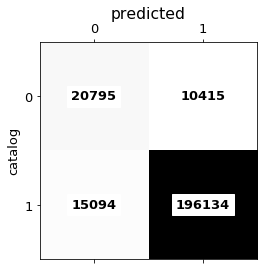

In [0]:
fig, ax = plt.subplots()
ax.matshow(cm, cmap='Greys')
plt.ylabel('catalog')
plt.title('predicted', y=1.08)

print('true negative rate (req. ~.7 - .8):   {}.'.format((cm[0,0]) / (cm[0,0] + cm[0,1])))
print('false negative (req. < 0.1): {}.'.format((cm[1,0]) / (cm[1,0] + cm[1,1])))

for (i, j), z in np.ndenumerate(cm):
    t = ax.text(j, i, '{:3.0f}'.format((z)), ha='center', va='center', weight='bold')
    t.set_bbox(dict(facecolor='white', alpha=1.0, edgecolor='white'))

plt.show()

We see that the neural network's performance does not match the other supervised methods. While it exhibits good false negative rates, it overpredicts detections as 'MATCH' objects (indicated by the very low false negative rate and very low true negative rate). 

# 4. Unsupervised Methods

We tried the following models:
- K-means
- Gaussian Mixture (EM)
- Variational Gaussian Mixture

From the EDA part, we can see that the features in the feature space is separable, and a gaussian approximation to the distribution is acceptable.

### Baseline Kmeans: 

We chose the most significant features that we discovered in previous supervised learning part, and pass them into kmeans algorithm:

In [0]:
Xcol_list = ['PSF_QF_PERFECT','SNR','MOMENTS_YY', 'PSF_QF']
col_list = ['RA_PSF','DEC_PSF','MATCH','EDGE']+Xcol_list
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)
warnings.filterwarnings(action='ignore')#, category=DataConversionWarning)

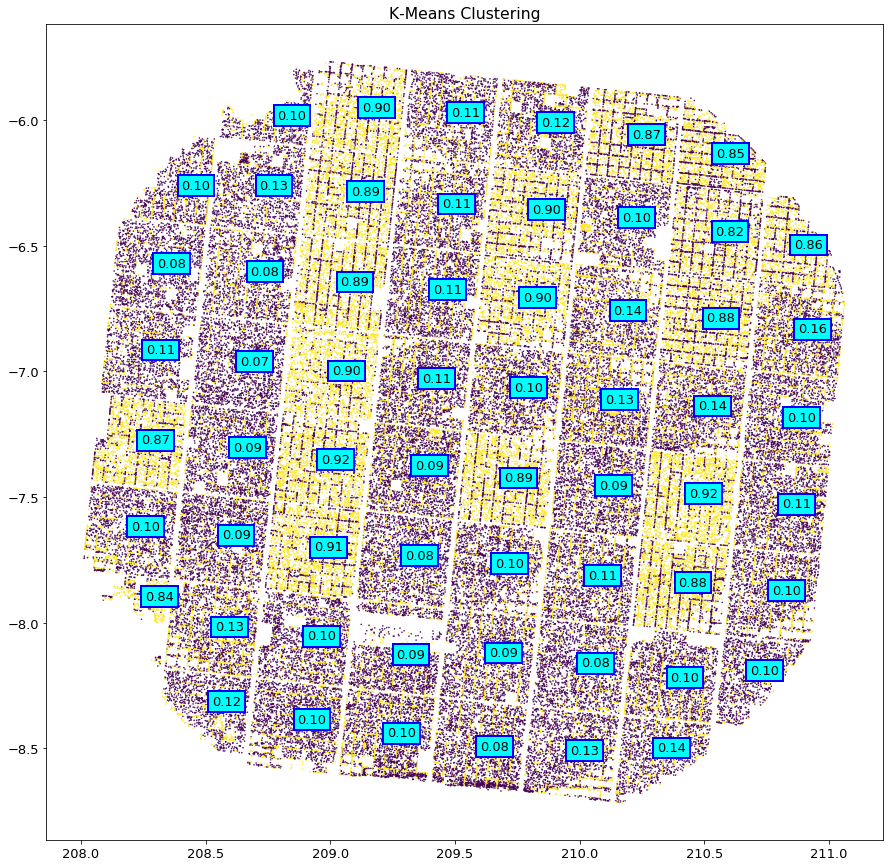

In [0]:
# empty callbacks
falsepos_catelog_percentage_over_chips=[]    
recalls=[]    
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
ax.set_title('K-Means Clustering')
for chip in chips:
    df = read_chip(chip, hdus)
    X00 = df[col_list].dropna()
    X0=X00[col_list]
    min_max_scaler = preprocessing.MinMaxScaler()
    X_scaled= min_max_scaler.fit_transform(X0)#df[col_list]
    X_scaled= pd.DataFrame(columns=col_list,data=X_scaled)
    # eervything scaled
#     init = X_scaled.groupby('MATCH',as_index=False).mean()
#     Xinit = init[Xcol_list]
    X = X_scaled[Xcol_list]
#     Xinit.head()
    model = KMeans(2 ).fit(X)
    labels = model.labels_
    cm = confusion_matrix(y_true=X_scaled['MATCH'], y_pred=labels)
    recall = cm[1,1]/sum(X_scaled['MATCH'])
    
    scatter = ax.scatter(X00['RA_PSF'], X00['DEC_PSF'],
                         c=labels ,s=0.3)
    
    plt.annotate("%0.2f"%recall,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )
    recalls.append(recall)    

**This model is quite successful in some chips, but since we cannot control the labels  due to random initialization of clusters, the cluster labels are randomly flipped.**


### Kmeans with initialization

With the lesson learned in the baseline model, we proposed an improvement on that. The initial assignment of dots are enforced by MATCH label. We got the benefit of exerting good initial guess of cluster centers, and at the same time, in the first cluster we expect real detections, and in the second one bogus. 

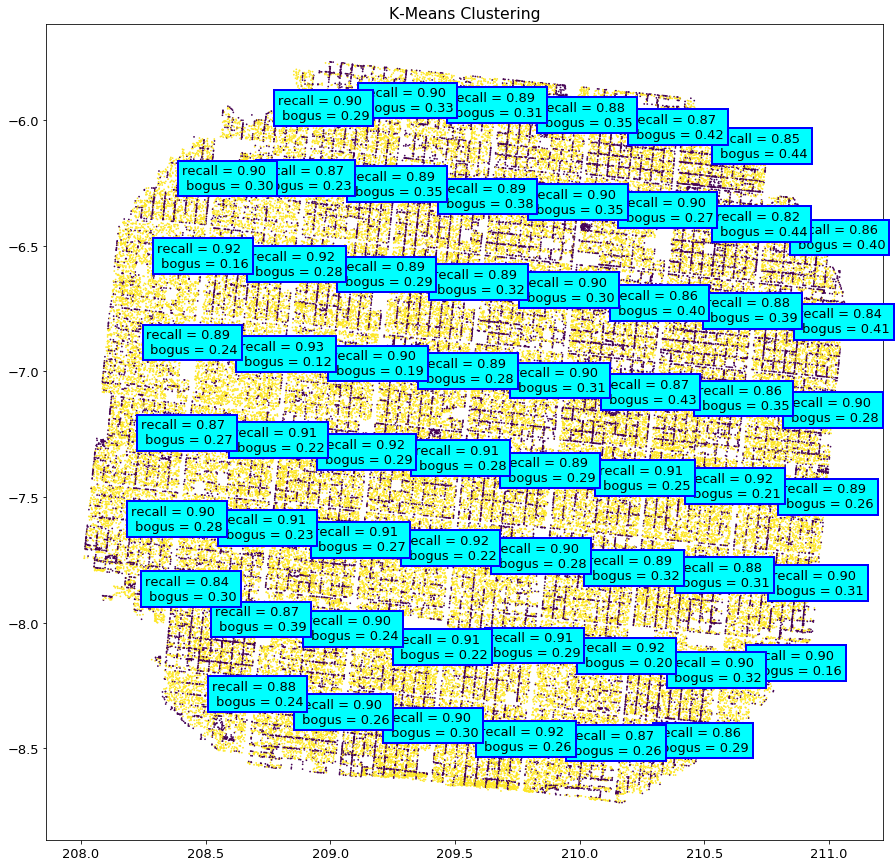

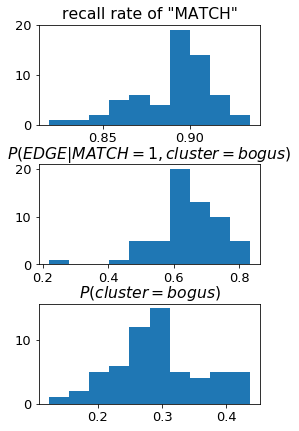

In [0]:
# empty callbacks
falsepos_catelog_percentage_over_chips=[]    
percentage_of_edge_bogus_in_match_bogus=[]
recalls=[]    
bogusrates = []

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
ax.set_title('K-Means Clustering')
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)

for chip in chips:
    df = read_chip(chip,hdus)
    X00 = df[col_list].dropna()
    X0=X00[col_list]
    min_max_scaler = preprocessing.MinMaxScaler()
    X_scaled= min_max_scaler.fit_transform(X0)#df[col_list]
    X_scaled= pd.DataFrame(columns=col_list,data=X_scaled)
    init = X_scaled.groupby('MATCH',as_index=False).mean().sort_values(by='MATCH')
    Xinit = init[Xcol_list]
    X = X_scaled[Xcol_list]
    
    model = KMeans(2, init = Xinit.values,n_init=1 ).fit(X)
    labels = model.labels_
    cm = confusion_matrix(y_true=X_scaled['MATCH'], y_pred=labels)
    recall = cm[1,1]/sum(X_scaled['MATCH'])

    scatter = ax.scatter(X00['RA_PSF'], X00['DEC_PSF'],
                         c=labels ,s=.5)
    bogusrate = 1-np.mean(labels)
    bogusrates.append(bogusrate)
    plt.annotate("recall = {0:.2f} \n bogus = {1:.2f}".format(recall,bogusrate) ,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )

    matched = X0['MATCH']==1
    bogus =model.labels_==0
    mb = matched & bogus
    edge_mb = np.sum(X0['EDGE'][mb])
    percentage_of_edge_bogus_in_match_bogus.append(edge_mb / np.sum(mb) )
    recalls.append(recall)
    
fig, ax = plt.subplots(3,1,figsize = (4,6))
plt.tight_layout()
ax[0].hist(recalls)
ax[0].set_title ('recall rate of "MATCH"')
ax[1].hist(percentage_of_edge_bogus_in_match_bogus)
ax[1].set_title (r'$P(EDGE|MATCH=1,cluster=bogus)$')
ax[2].hist(bogusrates)
ax[2].set_title (r'$P(cluster = bogus)$')
plt.show()

**The recall rate is good!**

**Here are some more explainations on the new metric, $\text{P }(\text{ EDGE }|\text{ MATCH},\text{cluster=bogus })$**

This quantity captures the percentage of EDGE==1, among those clustered to be bogus but still matches catelog.

This phenomenon arises because those MATCH==1 labels are not perfect. On cell edges there are more detections, but the distribution of stars in the sky in uniform in a small portion of the sky. Therefore, the excessive portion of detections in cell edges is highly likely to be bogus. In the mean time, because the high density of detections on cell edges, there is possibility that bogus points matches catelog by coincidence, therefore mistakenly labelled as MATCH. **This metric shows that our clustering procedure can not only get real detections from those thrown away by catelog matching, but also spot bogus detections that happened to MATCH. **

**For the metric $P(cluster = bogus)$**, is a proof read of ensuring we are not trivially predicting everything on our chip to be real.

### Expectation-Maximization algorithm

To go beyond linear decision boundaries, and to allow for different variances in features, we adopteded the EM algorithm, with initialization that is provided by kmeans.

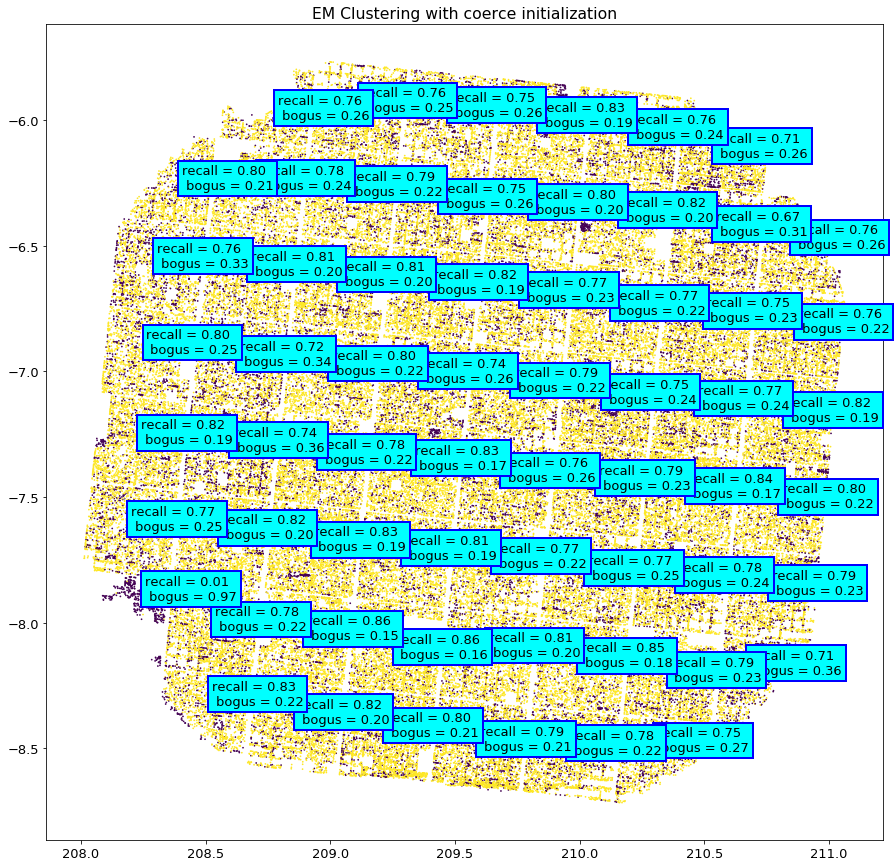

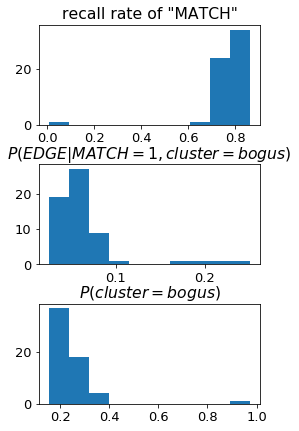

In [0]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
ax.set_title('EM Clustering with coerce initialization')
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)

# empty callbacks
falsepos_catelog_percentage_over_chips=[]    
percentage_of_edge_bogus_in_match_bogus=[]
recalls=[]    
bogusrates = []



for chip in chips:

    df = read_chip(chip,hdus)
    X00 = df[col_list].dropna()
    X0=X00[col_list]
    min_max_scaler = preprocessing.MinMaxScaler()
    X_scaled= min_max_scaler.fit_transform(X0)#df[col_list]
    X_scaled= pd.DataFrame(columns=col_list,data=X_scaled)

    init = X_scaled.groupby('MATCH',as_index=False).mean().sort_values(by='MATCH')
    Xinit = init[Xcol_list]
    X = X_scaled[Xcol_list]
    precisions_init = np.stack([np.diag(Xinit.values[0]),
                                np.diag(Xinit.values[1]) ],axis=0)/15
    modelGM = GaussianMixture(n_components=2, covariance_type= 'full', 
        tol=0.001, reg_covar=1e-06, max_iter=100, n_init=1,
        init_params= 'kmeans', #sklearn implemented kmeans initialization for us
        weights_init=None, means_init=Xinit.values,
        precisions_init=precisions_init, random_state=None, warm_start=False, 
        verbose=0, verbose_interval=10).fit(X)
    labels = modelGM.predict(X)
    
    cm = confusion_matrix(y_true=X00['MATCH'], y_pred=labels)
    recall = cm[1,1]/sum(X00['MATCH'])
    
    
    scatter = ax.scatter(X00['RA_PSF'], X00['DEC_PSF'],
                         c=labels ,s=.5)
    
    bogusrate = 1-np.mean(labels)
    bogusrates.append(bogusrate)
    
    plt.annotate("recall = {0:.2f} \n bogus = {1:.2f}".format(recall,bogusrate) ,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )
    matched = X0['MATCH']==1
    bogus =labels==0
    mb = matched & bogus
    edge_mb = np.sum(X0['EDGE'][mb])
    percentage_of_edge_bogus_in_match_bogus.append(edge_mb / np.sum(mb) )
    recalls.append(recall)
fig, ax = plt.subplots(3,1,figsize = (4,6))
plt.tight_layout()
ax[0].hist(recalls)
ax[0].set_title ('recall rate of "MATCH"')
ax[1].hist(percentage_of_edge_bogus_in_match_bogus)
ax[1].set_title (r'$P(EDGE|MATCH=1,cluster=bogus)$')
ax[2].hist(bogusrates)
ax[2].set_title (r'$P(cluster = bogus)$')
plt.show()

It seems that in some chips the label flipped and the recall rate is not ideal. This is because I set a prior which is too wide, namely 
```python
    precisions_init = np.stack([np.diag(Xinit.values[0]),
                                np.diag(Xinit.values[1]) ],axis=0)/15
```
we will try a more strict prior on the second cluster, which is initialized by MATCH, meanwhile keeping the wide prior for the first cluster unchanged.
```python
    precisions_init = np.stack([ np.diag( 1/Xinit.values[0] /10  ),
                                np.diag( 1/Xinit.values[1] /8  ) ],axis=0)
```

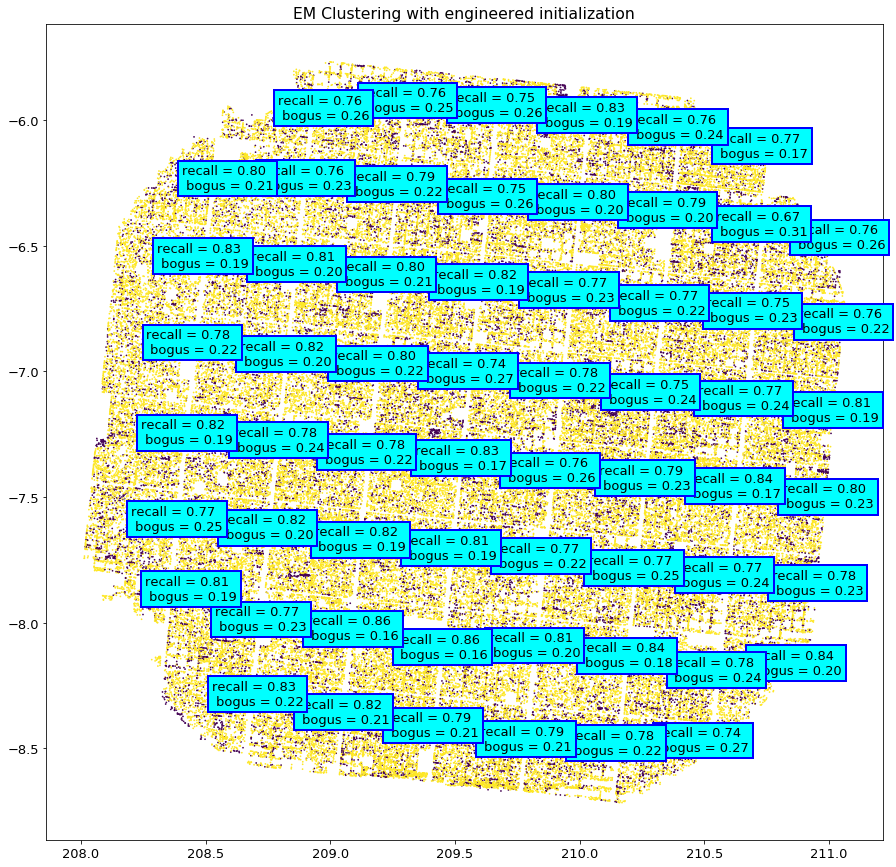

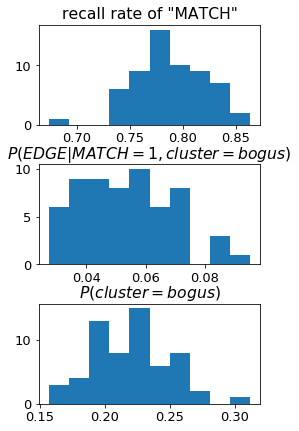

In [0]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
ax.set_title('EM Clustering with engineered initialization')
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)

# empty callbacks
falsepos_catelog_percentage_over_chips=[]    
percentage_of_edge_bogus_in_match_bogus=[]
recalls=[]    
bogusrates = []

for chip in chips:
    df = read_chip(chip,hdus)
    X00 = df[col_list].dropna()
    X0=X00[col_list]
    min_max_scaler = preprocessing.MinMaxScaler()
    X_scaled= min_max_scaler.fit_transform(X0)#df[col_list]
    X_scaled= pd.DataFrame(columns=col_list,data=X_scaled)

    init = X_scaled.groupby('MATCH',as_index=False).mean().sort_values(by='MATCH')
    Xinit = init[Xcol_list]
    X = X_scaled[Xcol_list]
    
#     print(Xinit.values)
    
    precisions_init = np.stack([ np.diag( 1/Xinit.values[0]/10   ),
                                 np.diag( 1/Xinit.values[1]/8   ) ],axis=0)
    ## inverse of covariance
    modelGM = GaussianMixture(n_components=2, covariance_type= 'full', 
        tol=0.001, reg_covar=1e-06, max_iter=100, n_init=1,
        init_params= 'kmeans', weights_init=None, means_init=Xinit.values,
        precisions_init=precisions_init, random_state=None, warm_start=False, 
        verbose=0, verbose_interval=10).fit(X)
    labels = modelGM.predict(X)
    
    cm = confusion_matrix(y_true=X_scaled['MATCH'], y_pred=labels)
    recall = cm[1,1]/sum(X_scaled['MATCH'])
    
    
    scatter = ax.scatter(X00['RA_PSF'], X00['DEC_PSF'],
                         c=labels ,s=.5)
    
    bogusrate = 1-np.mean(labels)
    bogusrates.append(bogusrate)
    
    plt.annotate("recall = {0:.2f} \n bogus = {1:.2f}".format(recall,bogusrate) ,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )
    matched = X0['MATCH']==1
    bogus =labels==0
    mb = matched & bogus
    edge_mb = np.sum(X0['EDGE'][mb])
    percentage_of_edge_bogus_in_match_bogus.append(edge_mb / np.sum(mb) )
    recalls.append(recall)
fig, ax = plt.subplots(3,1,figsize = (4,6))
plt.tight_layout()
ax[0].hist(recalls)
ax[0].set_title ('recall rate of "MATCH"')
ax[1].hist(percentage_of_edge_bogus_in_match_bogus)
ax[1].set_title (r'$P(EDGE|MATCH=1,cluster=bogus)$')
ax[2].hist(bogusrates)
ax[2].set_title (r'$P(cluster = bogus)$')
plt.show()

We see that by enforcing a strict prior on the cluster which is meant to be real, we observe in some chips, the recall rate achieved 100%. This means that some chips have very good feature consistency among all MATCHed object, while others do not. **This EM algorithm is very promising in solving this semi-supervised learning problem as long as we have very confident MATCH labels.**

### Variational gaussian mixture models

The structue of Variational gaussian mixture models is like following:


<!-- <img src=https://i.ibb.co/48MzvX1/image.png alt="Drawing" width="800"> --->
![hhhh](https://i.ibb.co/48MzvX1/image.png)

![hhh](https://upload.wikimedia.org/wikipedia/commons/thumb/2/28/Bayesian-gaussian-mixture.svg/300px-Bayesian-gaussian-mixture.svg.png)

Bayesian Gaussian mixture model using plate notation. Smaller squares indicate fixed parameters; larger circles indicate random variables. Filled-in shapes indicate known values. The indication [K] means a vector of size K.

*p.c. [wikipedia](https://en.wikipedia.org/wiki/Mixture_model)*


This model associates all parameters to random variables, and . 

Firstly, we have $\beta$ to represent the possibility of one observation to be true or bogus. 



Secondly, the center and variance of clusters $(\mu_k,\sigma_k)$, are generated by gaussian distributions characterized by parameters $\mu$, $\nu$, $\lambda$, $\sigma_0^2$. 

Given the cluster centers, observations are drawn from its corresponding cluster $(\mu_k,\sigma_k)$.

**This model is telling a more comprehensive story of how we observe the data we have collected. Since we are interested in telling whether a detection is real or bogus, therefore this model is well suited to our task**

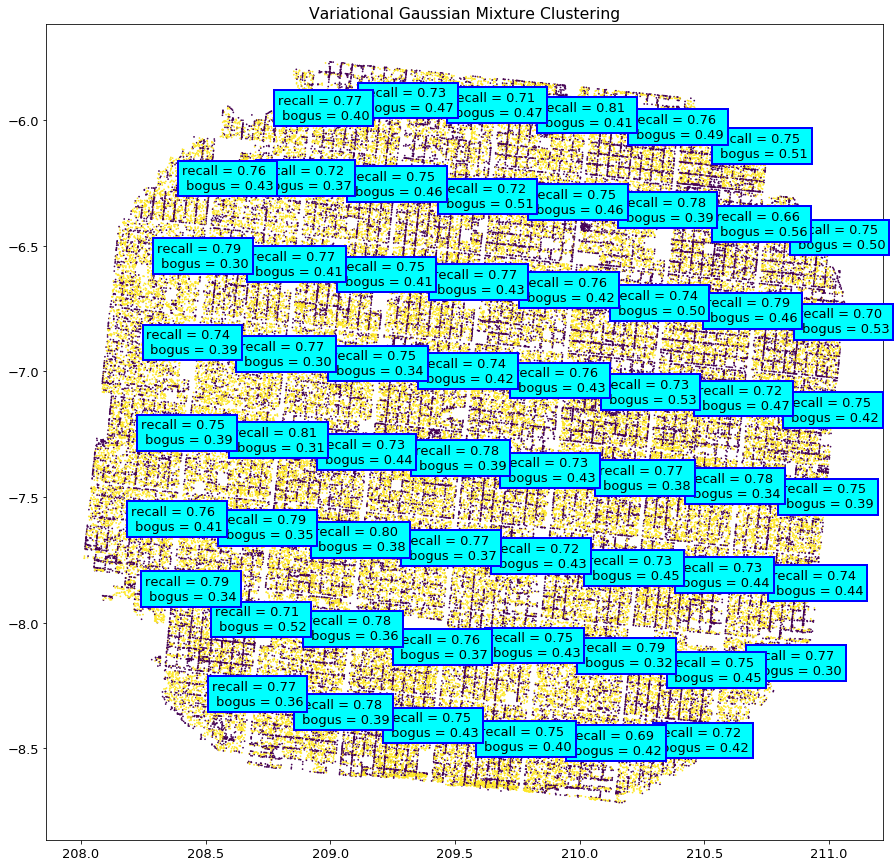

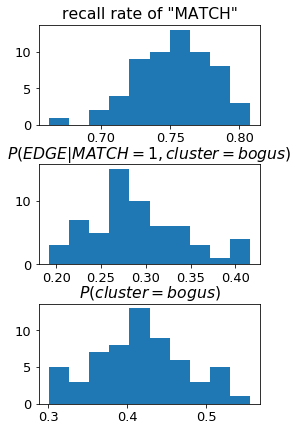

In [0]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111)
ax.set_title('Variational Gaussian Mixture Clustering')
bbox_props = dict(boxstyle="square,pad=0.3", fc="cyan", ec="b", lw=2)

# empty callbacks
falsepos_catelog_percentage_over_chips=[]    
percentage_of_edge_bogus_in_match_bogus=[]
recalls=[]    
bogusrates = []


for chip in chips:
    df = read_chip(chip,hdus)
    X00 = df[col_list].dropna()
    X0=X00[col_list]
    min_max_scaler = preprocessing.MinMaxScaler()
    X_scaled= min_max_scaler.fit_transform(X0)#df[col_list]
    X_scaled= pd.DataFrame(columns=col_list,data=X_scaled)
    X = X_scaled[Xcol_list]

    labels = BayesianGaussianMixture(n_components=2, covariance_type= 'full').fit_predict(X)
    
    cm = confusion_matrix(y_true=X_scaled['MATCH'], y_pred=labels)
    recall = cm[1,1]/sum(X_scaled['MATCH'])
        
    
    if recall< 0.5:
        labels=1-labels

    cm = confusion_matrix(y_true=X0['MATCH'], y_pred=labels )    
    recall = cm[1,1]/sum(X_scaled['MATCH'])
    scatter = ax.scatter(X00['RA_PSF'], X00['DEC_PSF'],
                         c=labels,s=.5)
    
    
    bogusrate = 1-np.mean(labels)
    bogusrates.append(bogusrate)
    plt.annotate("recall = {0:.2f} \n bogus = {1:.2f}".format(recall,bogusrate) ,(df['RA_PSF'].mean(), df['DEC_PSF'].mean()),bbox=bbox_props )
    matched = X0['MATCH']==1
    bogus =labels==0
    mb = matched & bogus
    edge_mb = np.sum(X0['EDGE'][mb])
    percentage_of_edge_bogus_in_match_bogus.append(edge_mb / np.sum(mb) )
    recalls.append(recall)
fig, ax = plt.subplots(3,1,figsize = (4,6))
plt.tight_layout()
ax[0].hist(recalls)
ax[0].set_title ('recall rate of "MATCH"')
ax[1].hist(percentage_of_edge_bogus_in_match_bogus)
ax[1].set_title (r'$P(EDGE|MATCH=1,cluster=bogus)$')
ax[2].hist(bogusrates)
ax[2].set_title (r'$P(cluster = bogus)$')
plt.show()

This model is outperforming every model that we have tried previously, as we can read from the histograms of metrics, having reasonable MATCH recalls, high edgebogus rates, but realatively high rejection rates.  

### Metrics for Unsupervised Methods

We have measured recall rate of "MATCH", $P(EDGE|MATCH=1,cluster=bogus)$, $P(cluster = bogus)$ in the cells, and they turn out very good. As a proof of the stability and self-consistency of the algorithm, we made a train-test split on each chip. We cluster on the training set, and use the trained decision boundary to predict in the test set. In each individual chip, we collect the three pairs of measures, and made paired t-test over the 60 measurements for each chip. We repeat the process for each smf file, and collected the p-values of those t-tests

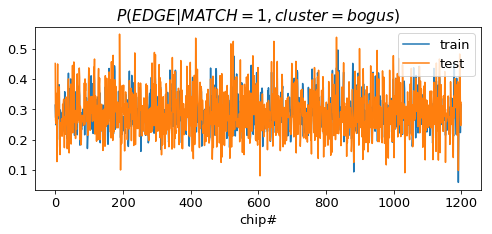

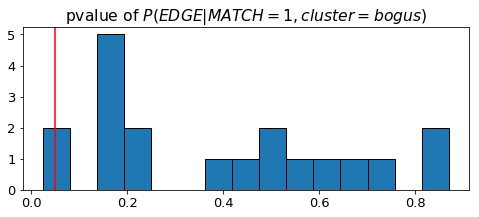

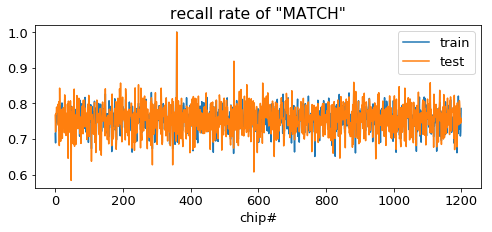

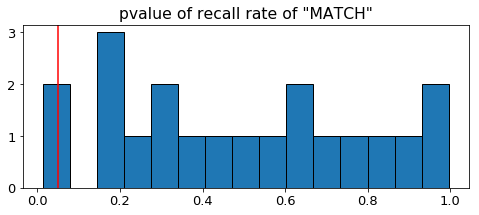

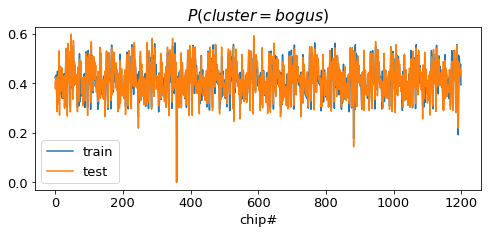

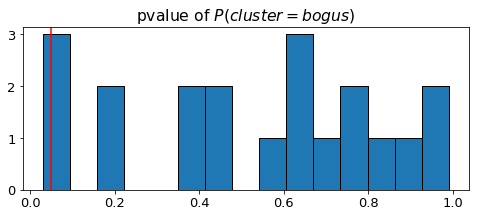

In [0]:
falsepos_catelog_percentage_over_chips=[]    
percentage_of_edge_bogus_in_match_bogus=[]
recalls=[]    
bogusrates = []

i = 0

for smf_name, smf_file in tqdm(smf_store.items()):
    i += 1
    #hdus = 
    # for chip in chips[::5]:
    for chip in chips:

        df = read_chip(chip, hdus )
        X00 = df[col_list].dropna()   

    #     print(np.sum(np.isnan(X00)))
        Y00 = X00['MATCH']  
    #     X0=X00[Xcol_list]
    #     Y0=X00['MATCH']    
    #     lenn = len(Y0)
    #     X_test_index=np.random.choice(lenn, , replace=False)
        # stratefy split, get index
        lenn1 = sum(Y00==1)
        lenn0 = sum(Y00==0)
        lenn = len(Y00)
        ind1 = np.random.choice(np.where(Y00==1)[0],size=lenn1//5 )
        ind0 = np.random.choice(np.where(Y00==0)[0],size=lenn0//5 )

        test_index = np.append(ind0,ind1)
        train_index = np.setdiff1d(np.arange(lenn),test_index)

    #     X_train = X00[Xcol_list][train_index]
        X_train = X00.iloc[train_index][Xcol_list]

        X_test = X00.iloc[test_index][Xcol_list]
    #     print(np.sum(np.isnan(X_train)))
    #     X_test = X00[Xcol_list][test_index]
        y_train = Y00.iloc[train_index]
        y_test = Y00.iloc[test_index]

        min_max_scaler = preprocessing.MinMaxScaler()
        min_max_scaler.fit(X_train)

        X_train_scaled = min_max_scaler.transform(X_train)
        X_test_scaled = min_max_scaler.transform(X_test)

        model = BayesianGaussianMixture(n_components=2, covariance_type= 'full').fit(X_train_scaled)

        train_labels = model.predict(X_train_scaled)
        test_labels = model.predict(X_test_scaled)



        cm_train = confusion_matrix(y_true=y_train, y_pred=train_labels)
        recall = cm_train[1,1]/sum( y_train )


        if recall< 0.5:
            train_labels = 1-train_labels
            test_labels = 1- test_labels
            cm_train = confusion_matrix(y_true=y_train, y_pred=train_labels)
        cm_test = confusion_matrix(y_true=y_test, y_pred=test_labels)

        #scatter = ax.scatter(X00['RA_PSF'][test_index], X00['DEC_PSF'][test_index],
        #                     c=test_labels,s=2)


        testbogusrate = 1-np.mean(test_labels)
        #plt.annotate("val_recall = {0:.2f} \n val_bogus = {1:.2f}".format(cm_test[1,1]/sum( test_labels ),testbogusrate)
        #             ,(X00['RA_PSF'] .mean(), X00['DEC_PSF'] .mean()),bbox=bbox_props )


        bogus = train_labels==0
        train_mb = y_train & bogus
        tmp = X00.iloc[train_index]['EDGE'].values
    #     print(type(tmp),type(train_mb.values))
        train_emb = np.sum(np.logical_and(tmp, train_mb.values ))/np.sum(train_mb)

        bogus = test_labels==0
        test_mb = y_test & bogus
        tmp = X00.iloc[test_index]['EDGE'].values
        test_emb = np.sum(np.logical_and(tmp, test_mb.values ))/np.sum(test_mb)

        train_br = 1-np.sum(train_labels)/len(train_labels)
        test_br = 1-np.sum(test_labels)/len(test_labels)

        percentage_of_edge_bogus_in_match_bogus.append([train_emb,test_emb])
        recalls.append([cm_train[1,1]/sum( y_train ),cm_test[1,1]/sum( y_test )])
        bogusrates.append( [train_br , test_br] )

    
plt.figure(figsize=(8,3))
plt.title (r'$P(EDGE|MATCH=1,cluster=bogus)$')
data = np.array(percentage_of_edge_bogus_in_match_bogus)
plt.plot(data[:,0],label='train')
plt.plot(data[:,1],label='test')
plt.xlabel('chip#')
plt.legend()
plt.show()

p_val_hist = []
base = 0
while base < len(data):
    mini_test = []
    for i in range(60):
        mini_test.append(data[i+base,:])
    base += 60
    mini_test = np.array(mini_test)
    p_val_hist.append(ttest_rel(mini_test[:,0],mini_test[:,1])[1])

fig = plt.figure(figsize=(8,3))
plt.hist(p_val_hist, edgecolor='k', bins=15)
plt.axvline(x=0.05, c='r')
plt.title('pvalue of $P(EDGE|MATCH=1,cluster=bogus)$')
#plt.xlabel('??')
plt.show()

#print('pvalue=',pvalue)

plt.figure(figsize=(8,3))
plt.title ('recall rate of "MATCH"')
data = np.array(recalls)
plt.plot(data[:,0],label='train')
plt.plot(data[:,1],label='test')
plt.xlabel('chip#')
plt.legend()
plt.show()
# pvalue  = ttest_rel(data[0],data[1])[1]
# print('pvalue=',pvalue)

p_val_hist = []
base = 0
while base < len(data):
    mini_test = []
    for i in range(60):
        mini_test.append(data[i+base,:])
    base += 60
    mini_test = np.array(mini_test)
    p_val_hist.append(ttest_rel(mini_test[:,0],mini_test[:,1])[1])

fig = plt.figure(figsize=(8,3))
plt.hist(p_val_hist, edgecolor='k', bins=15)
plt.axvline(x=0.05, c='r')
plt.title('pvalue of recall rate of "MATCH"')
#plt.xlabel('??')
plt.show()


plt.figure(figsize=(8,3))
plt.title (r'$P(cluster = bogus)$')
data = np.array(bogusrates)
plt.plot(data[:,0],label='train')
plt.plot(data[:,1],label='test')
plt.xlabel('chip#')
plt.legend()
plt.show()
# pvalue  = ttest_rel(data[0],data[1])[1]
# print('pvalue=',pvalue)

p_val_hist = []
base = 0
while base < len(data):
    mini_test = []
    for i in range(60):
        mini_test.append(data[i+base,:])
    base += 60
    mini_test = np.array(mini_test)
    p_val_hist.append(ttest_rel(mini_test[:,0],mini_test[:,1])[1])

fig = plt.figure(figsize=(8,3))
plt.hist(p_val_hist, edgecolor='k', bins=15)
plt.axvline(x=0.05, c='r')
plt.title('pvalue of $P(cluster = bogus)$')
#plt.xlabel('??')
plt.show()

We see that the distribution of p-values are well above 0.05 significance level, therefore we can say that variational Gaussian mixture models are yielding quite self-consistent result.

### summary for unsupervised models

Starting from the assumption that real/bogus detections hold distinguishable patterns in feature space, we made unsupervised models in the endeavor to figure out which detections are real whereas which are bogus. Our models include:

- KMeas(k=2)
- EM algorithm
- Bayesian Gaussian mixture model

 Over the 60 chips available, EM and KMeans models have a recall rate more than 95% on MATCH objects. Bayesian Gaussian mixture model has a model of 85% on recall rate. EM and Bayesian Gaussian mixture model have an increase in 100% recall instances, indicating that in some chips MATCH objects have good consistency.

Using any of the models above, we can expect two favorable outcomes:
1. Pick up real detections from non-matches: unidentified planetesimals, moving near-earth objects are usually hard to find in catelogues. But we definitely do not want them to slip away due to misclassification. Using those models, we can pick interested objects from our new labels, and keep track of them over time.

2. Spot bogus detections in MATCH. Even if there is a match in position with catelogue, we still cannot guarantee that this object is real, because bogus detections have a chance to appear right at the place of a catalogued object.



# 6. Discussion
In order to truely understand how well our unsupervised methods are performing with regard to solving the problem of picking bogus detections from real ones, we need authentic labels that indicate whther this detection is real or not. But sadly such infomation is not easy to get, and is expected to take too much time that Astronomers can afford. Therefore, although the above unsupervised result is self-consistent and performing well, we still worry about how this result compare to ground truth.

To collect ground thruth data, possible practices involve manual examination of each detection, and label real/bogus carefully according to not only position but also luminosity, shape, parallax and other parameters that could help distinguish bogus detections from real ones. We expect the real labels to come out some day.
